# Step 1.1 - Prepare network data
## Project: Growing Urban Bicycle Networks

This notebook downloads bicycle and street network data sets and prepares them for analysis.

Contact: Michael Szell (michael.szell@gmail.com)  
Created: 2020-06-09  
Last modified: 2021-03-10

## Preliminaries

### Parameters

In [1]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

Loaded parameters.



### Setup

In [2]:
%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

Loaded PATH.

Setup finished.

Python implementation: CPython
Python version       : 3.8.2
IPython version      : 8.5.0

Compiler    : Clang 9.0.1 
OS          : Darwin
Release     : 18.7.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

Git hash: 40ca8c59f7b566fe66060109a7898e6e783a4eca

osmnx     : 0.16.2
sys       : 3.8.2 | packaged by conda-forge | (default, Apr 24 2020, 07:56:27) 
[Clang 9.0.1 ]
json      : 2.0.9
pyproj    : 3.4.0
geopandas : 0.11.1
numpy     : 1.23.3
shapely   : 1.8.4
sklearn   : 1.1.2
networkx  : 2.8.6
csv       : 1.0
pandas    : 1.4.4
matplotlib: 3.6.0
fiona     : 1.8.21
watermark : 2.3.1
geojson   : 2.5.0
igraph    : 0.9.1
osgeo     : 3.2.1



### Functions

In [126]:
%run -i functions.py

Loaded functions.



## Download and wrangle data

### Networks

In [4]:
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    if placeinfo["nominatimstring"] != '':
        location = ox.geocoder.geocode_to_gdf(placeinfo["nominatimstring"])
        location = fill_holes(extract_relevant_polygon(placeid, shapely.geometry.shape(location['geometry'][0])))
        if debug: # Draw location polygons and their holes
            try:
                color = cm.rainbow(np.linspace(0,1,len(location)))
                for poly,c in zip(location, color):
                    plt.plot(*poly.exterior.xy, c = c)
                    for intr in poly.interiors:
                        plt.plot(*intr.xy, c = "red")
            except:
                plt.plot(*location.exterior.xy)
            plt.show()
    else:
        # https://gis.stackexchange.com/questions/113799/how-to-read-a-shapefile-in-python
        shp = fiona.open(PATH["data"] + placeid + "/" + placeid + ".shp")
        first = next(iter(shp))
        location = shapely.geometry.shape(first['geometry'])
    
    Gs = {}
    for parameterid, parameterinfo in tqdm(osmnxparameters.items(), desc = "Networks", leave = False):
        for i in range(0,10): # retry
            try:
                Gs[parameterid] = ox.graph_from_polygon(location, 
                                       network_type = parameterinfo['network_type'],
                                       custom_filter = (parameterinfo['custom_filter']),
                                       retain_all = parameterinfo['retain_all'],
                                       simplify = False)
            except ValueError:
                Gs[parameterid] = nx.empty_graph(create_using = nx.MultiDiGraph)
                print(placeid + ": No OSM data for graph " + parameterid + ". Created empty graph.")
                break
            except ConnectionError or UnboundLocalError:
                print("ConnectionError or UnboundLocalError. Retrying.")
                continue
            except:
                print("Other error. Retrying.")
                continue
            break
        if parameterinfo['export']: ox_to_csv(Gs[parameterid], PATH["data"] + placeid + "/", placeid, parameterid)
         
    # Compose special cases biketrack, bikeable, biketrackcarall
    parameterid = 'biketrack'
    Gs[parameterid] = nx.compose_all([Gs['bike_cyclewaylefttrack'], Gs['bike_cyclewaytrack'], Gs['bike_highwaycycleway'], Gs['bike_bicycleroad'], Gs['bike_cyclewayrighttrack'], Gs['bike_designatedpath'], Gs['bike_cyclestreet']])
    ox_to_csv(Gs[parameterid], PATH["data"] + placeid+ "/", placeid, parameterid)
    
    parameterid = 'bikeable'
    Gs[parameterid] = nx.compose_all([Gs['biketrack'], Gs['car30'], Gs['bike_livingstreet']]) 
    ox_to_csv(Gs[parameterid], PATH["data"] + placeid + "/", placeid, parameterid)
    
    parameterid = 'biketrackcarall'
    Gs[parameterid] = nx.compose(Gs['biketrack'], Gs['carall']) # Order is important
    ox_to_csv(Gs[parameterid], PATH["data"] + placeid + "/", placeid, parameterid)
    
    print([k for k in Gs ])
    
    for parameterid in networktypes[:-2]:
        #G_temp = nx.MultiDiGraph(ox.utils_graph.get_digraph(ox.simplify_graph(Gs[parameterid]))) # This doesnt work - cant get rid of multiedges
        ox_to_csv(ox.simplify_graph(Gs[parameterid]), PATH["data"] + placeid + "/", placeid, parameterid, "_simplified")
   

Cities:   0%|          | 0/1 [00:00<?, ?it/s]

Networks:   0%|          | 0/10 [00:00<?, ?it/s]

/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:281: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for polygon in geometry:
/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:375: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in multipoly:
/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:375: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in multipoly:


copenhagen: Successfully wrote graph car30


/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:281: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for polygon in geometry:
/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:375: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in multipoly:
/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:375: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in multipoly:


copenhagen: Successfully wrote graph carall


/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:281: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for polygon in geometry:
/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:375: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in multipoly:
/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/osmnx/utils_geo.py:375: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in multipoly:
/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/si

copenhagen: Successfully wrote graph biketrack
copenhagen: Successfully wrote graph bikeable
copenhagen: Successfully wrote graph biketrackcarall
['car30', 'carall', 'bike_cyclewaytrack', 'bike_highwaycycleway', 'bike_designatedpath', 'bike_cyclewayrighttrack', 'bike_cyclewaylefttrack', 'bike_cyclestreet', 'bike_bicycleroad', 'bike_livingstreet', 'biketrack', 'bikeable', 'biketrackcarall']
copenhagen: Successfully wrote graph biketrack_simplified
copenhagen: Successfully wrote graph carall_simplified
copenhagen: Successfully wrote graph bikeable_simplified
copenhagen: Successfully wrote graph biketrackcarall_simplified


In [5]:
# Compress all data files (will not do anything if files were compressed already)
for folder, subfolders, files in os.walk(PATH["data"]):
    for file in files:
        if file.endswith('es.csv'):
            compress_file(folder + "/", file.split(".")[0])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


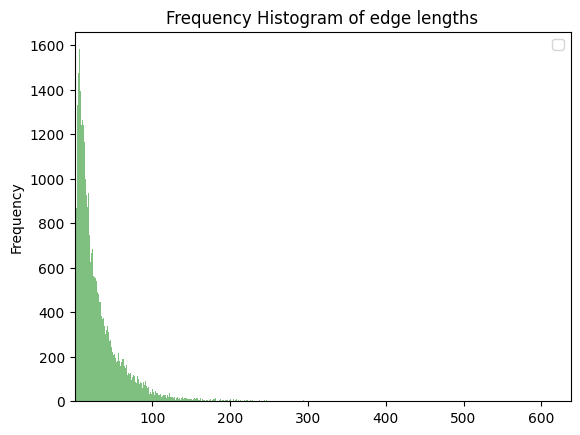

In [6]:
len_dict = nx.get_edge_attributes(Gs['carall'], "length")
dict_to_histogram(len_dict, "edge lengths")

In [3]:
pop_den_df

NameError: name 'pop_den_df' is not defined

In [2]:
df_to_histogram(pop_den_df[], "edge lengths")

NameError: name 'df_to_histogram' is not defined

In [7]:
length_mean = statistics.mean([k for k in len_dict.values()])

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/mean_length.pkl', 'wb') as f:
    pickle.dump(length_mean, f)

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/edges_dict_length.pkl', 'wb') as f:
    pickle.dump(len_dict, f)

#ox_to_csv(Gs['carall'], PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')
#ox_to_csv(ox.simplify_graph(Gs['carall']), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")
#ox.save_graphml(Gs['carall'], "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")

In [11]:
pop_den_df = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/bikedata/dnk_pd_2019_1km_ASCII_XYZ.csv")
#pop_den_df = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/bikedata/dnk_pd_2019_1km_ASCII_XYZ_small.csv")

#convert to fraction. All pop densities are added 1 to avoid division by zero (if zero density).
pop_den_df['pop_den_attr']= pop_den_df['Z']
for i in range(len(pop_den_df['Z'])):
    pop_den_df['pop_den_attr'].iloc[i] = 1.0/float(pop_den_df['pop_den_attr'].iloc[i]+1)

pop_den_df.rename(columns = {'X':'long', 'Y':'lat','Z':'pop_den'}, inplace = True)

In [155]:
pop_den_df['pop_den'].describe()

count    94677.000000
mean       134.226144
std        599.501218
min          0.041872
25%         10.456241
50%         20.628866
75%         54.683216
max      35463.503906
Name: pop_den, dtype: float64

In [216]:
len(pop_den_df)

94677

In [217]:
len(G_carall.edges())

66053

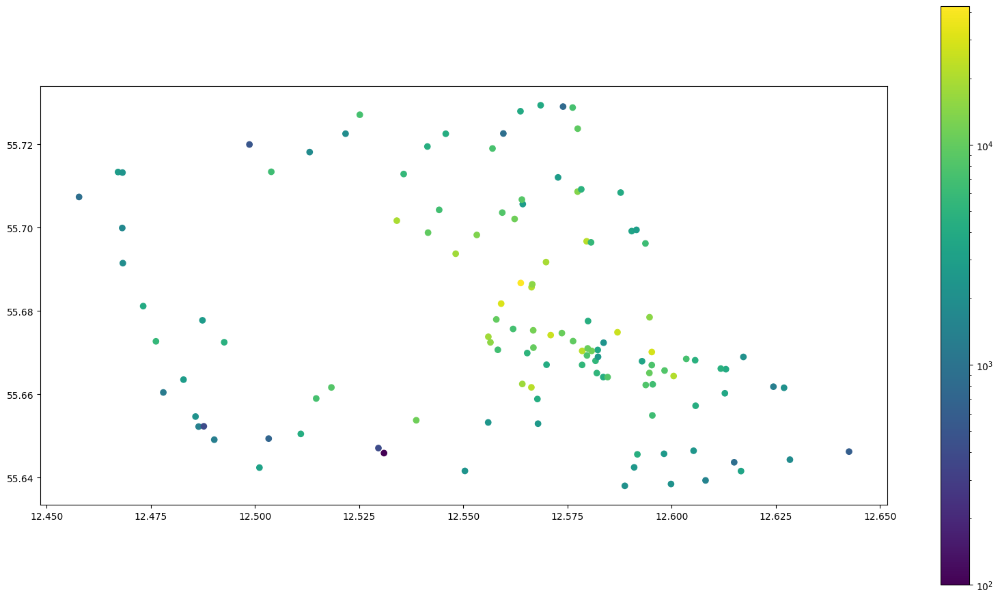

In [183]:
norm = matplotlib.colors.LogNorm(vmin=bikelanes.bicycle_count.min(), vmax=bikelanes.bicycle_count.max())

bikelanes.plot("bicycle_count", 
                                   figsize=(20, 11), 
                                   legend=True,  
                                   norm=norm);



In [185]:
import contextily as ctx
lanes = ox.graph_to_gdfs(Gs['carall'], nodes=False)


AttributeError: 'Graph' object has no attribute 'graph'

In [187]:
poplanes = gpd.GeoDataFrame(pop_den_df, geometry=gpd.points_from_xy(pop_den_df['long'], pop_den_df['lat']))

In [197]:
pop_den_df_cph = pd.DataFrame([pop_den_df.iloc[i] for i in L])

In [199]:
pop_den_df_cph

,long,lat,pop_den,pop_den_attr,geometry
53644,12.494583,55.728750,2697.291260,0.000371,POINT (12.49458328424724 55.72874995923848)
53648,12.527917,55.728750,4757.211914,0.000210,POINT (12.52791661744724 55.72874995923848)
53649,12.536250,55.728750,2580.804199,0.000387,POINT (12.53624995074724 55.72874995923848)
53650,12.544583,55.728750,4207.012207,0.000238,POINT (12.544583284047242 55.72874995923848)
53651,12.552917,55.728750,3687.937744,0.000271,POINT (12.55291661734724 55.72874995923848)
...,...,...,...,...,...
59271,12.519583,55.612083,220.315689,0.004518,POINT (12.51958328414724 55.61208329303848)
59272,12.527917,55.612083,128.061630,0.007748,POINT (12.52791661744724 55.61208329303848)
59273,12.536250,55.612083,84.988068,0.011630,POINT (12.53624995074724 55.61208329303848)
59274,12.544583,55.612083,79.644485,0.012400,POINT (12.544583284047242 55.61208329303848)


In [200]:
poplanes_cph = gpd.GeoDataFrame(pop_den_df_cph, geometry=gpd.points_from_xy(pop_den_df_cph['long'], pop_den_df_cph['lat']))

<AxesSubplot: >

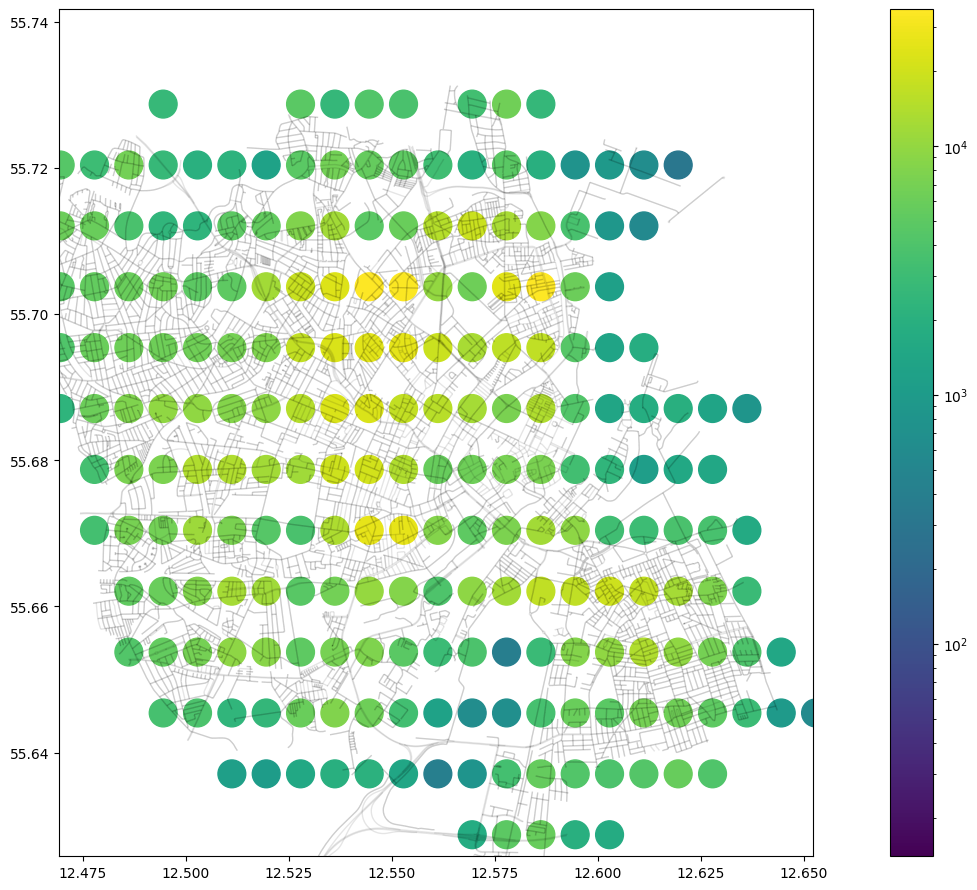

In [215]:
poplanes_cph.crs = "EPSG:4326"

norm = matplotlib.colors.LogNorm(vmin=poplanes_cph.pop_den.min()*5, vmax=poplanes_cph.pop_den.max())
fig = poplanes_cph.plot("pop_den", 
                                   figsize=(20, 11),
            
                                   legend=True,
                     
                        markersize=400,
                                   norm=norm);
fig.set_xlim(12.469380, 12.652281)
fig.set_ylim(55.625802, 55.741728)

ax = fig

lanes.plot(ax=ax, marker='x', color='black', linewidth = 1, alpha = 0.1)


#norm2 =  matplotlib.colors.LogNorm(vmin=bikelanes.bicycle_count.min(), vmax=bikelanes.bicycle_count.max())


#import contextily as ctx
#ax = fig
#bikelanes.plot(ax=ax, marker= "s")

#plt.axis([12.469380, 12.652281, 55.625802, 55.741728])
#plt.show()

#ctx.add_basemap(
#    ax,
    # CRS definition. Without the line below, the map stops making sense
 #   crs='epsg:4326',
#)

In [13]:
networktypes = ['biketrack',
 'carall',
 'bikeable',
 'biketrackcarall']


In [318]:
pop_den_attr_dict = nx.get_edge_attributes(G_carall, 'pop_den_attr')

In [323]:
pop_den_attr_dict = normalise_edge_dict(pop_den_attr_dict)

In [324]:
min(pop_den_attr_dict.values())

0.0

In [325]:
max(pop_den_attr_dict.values())

1.0

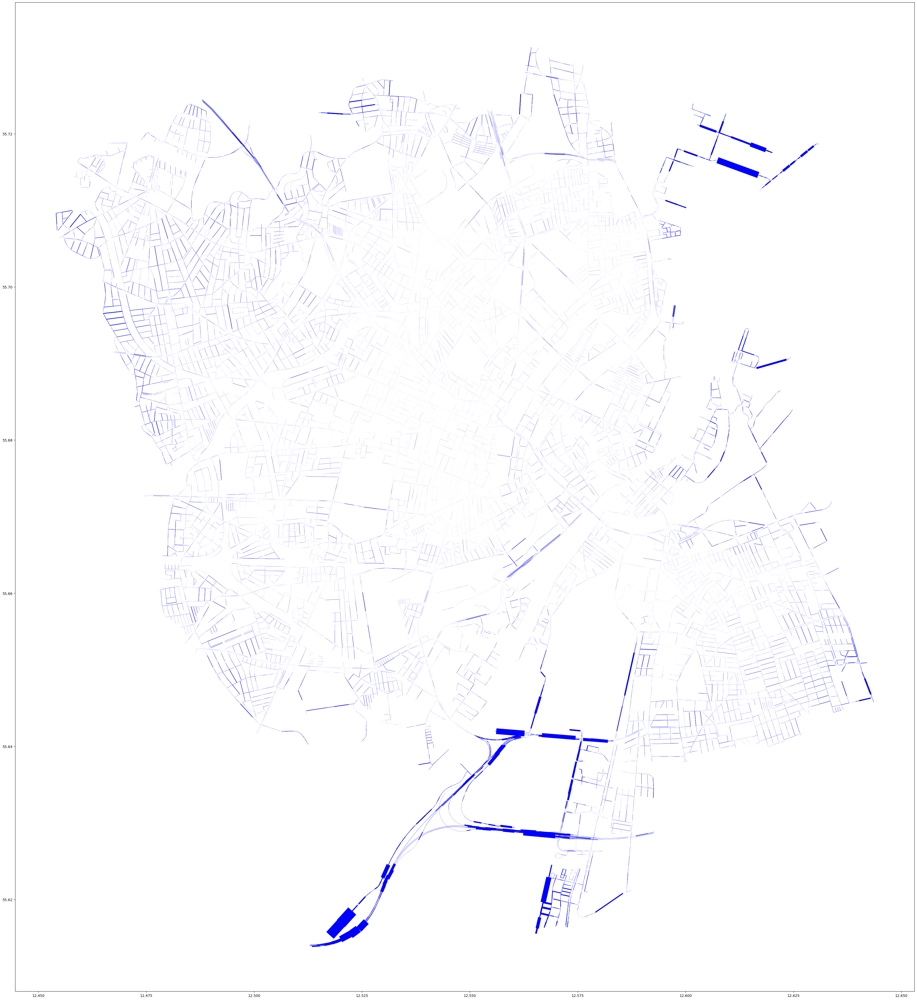

In [328]:
#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [pop_den_attr_dict[k]  for k in pop_den_attr_dict]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [pop_den_attr_dict[k]*30  for k in pop_den_attr_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= 1, linewidth = lc)


plt.show()

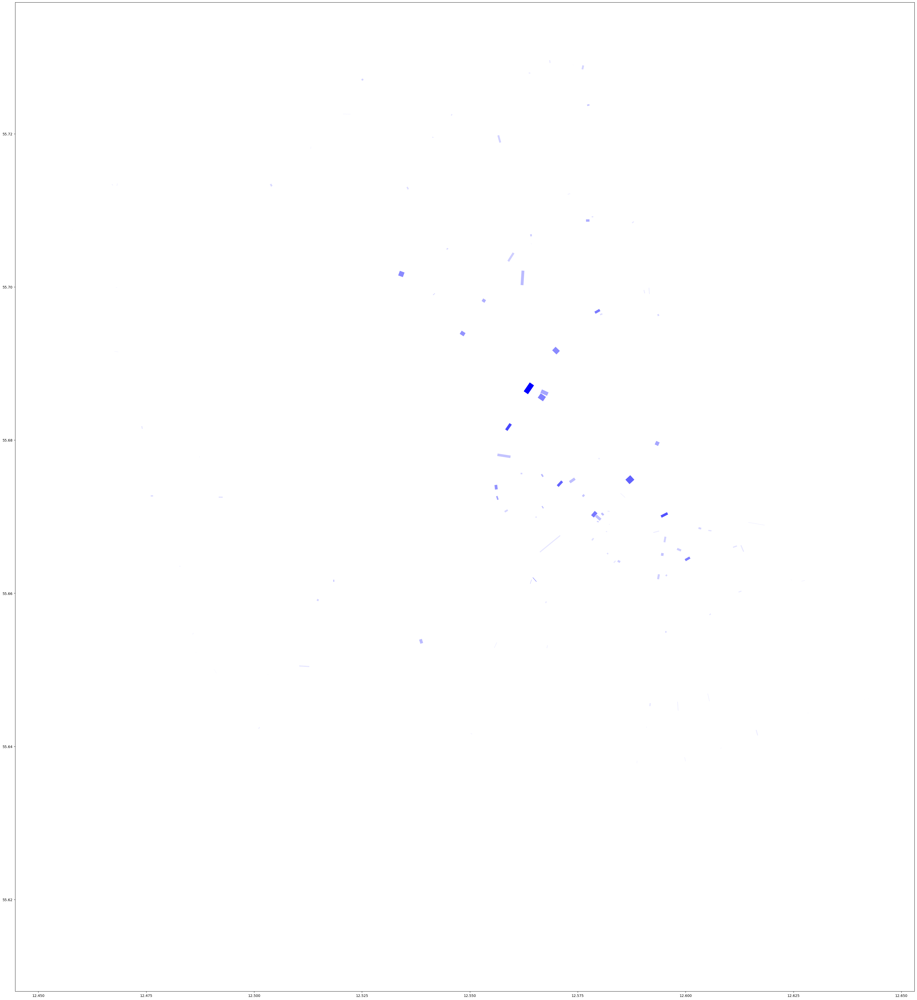

In [331]:
bcount_attr_dict = nx.get_edge_attributes(G_carall, 'bcount_attr')

bcount_attr_dict  = normalise_edge_dict(bcount_attr_dict )

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [bcount_attr_dict[k]  for k in bcount_attr_dict]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [bcount_attr_dict[k]*30  for k in bcount_attr_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

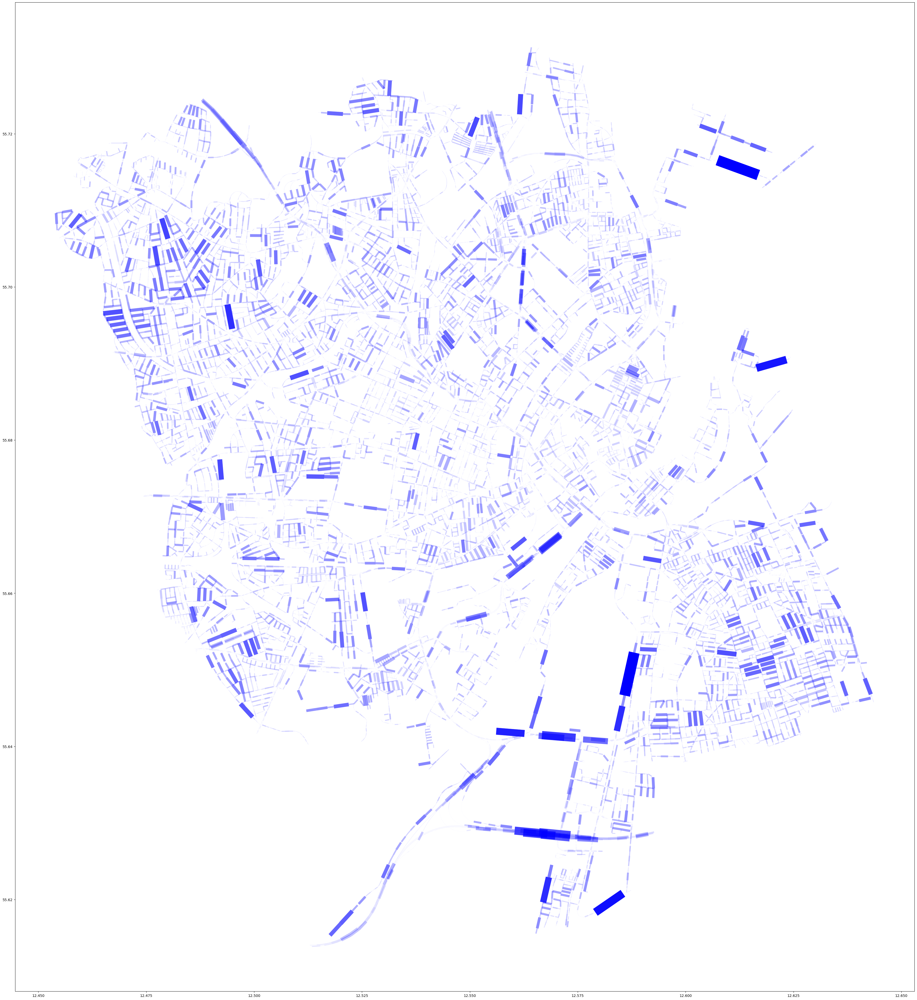

In [334]:
bcount_attr_dict = nx.get_edge_attributes(G_carall, 'length')

bcount_attr_dict  = normalise_edge_dict(bcount_attr_dict )

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [1.0 if bcount_attr_dict[k] == 1.0000000000000002 else bcount_attr_dict[k]  for k in bcount_attr_dict]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [bcount_attr_dict[k]*30  for k in bcount_attr_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

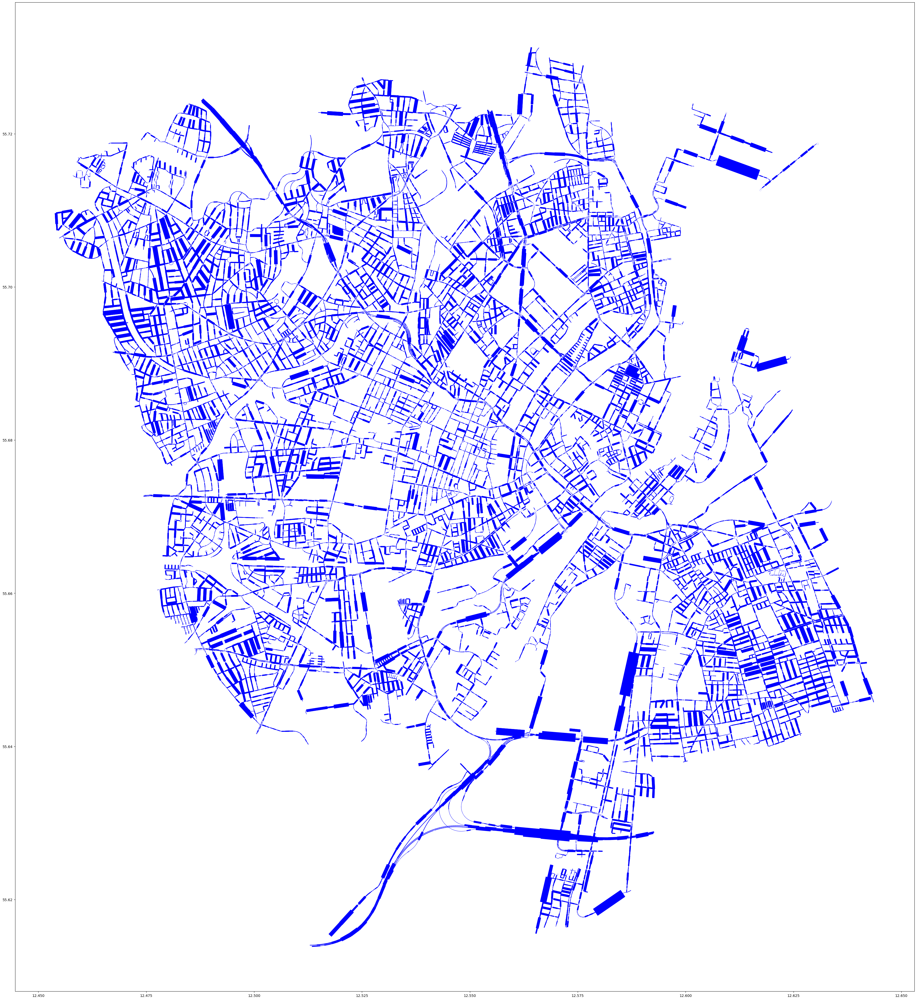

In [337]:
bcount_attr_dict = nx.get_edge_attributes(G_carall, 'length')

bcount_attr_dict  = normalise_edge_dict(bcount_attr_dict )

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [1.0 if bcount_attr_dict[k] == 1.0000000000000002 else bcount_attr_dict[k]  for k in bcount_attr_dict]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [bcount_attr_dict[k]*30  for k in bcount_attr_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= 1, linewidth = lc)


plt.show()

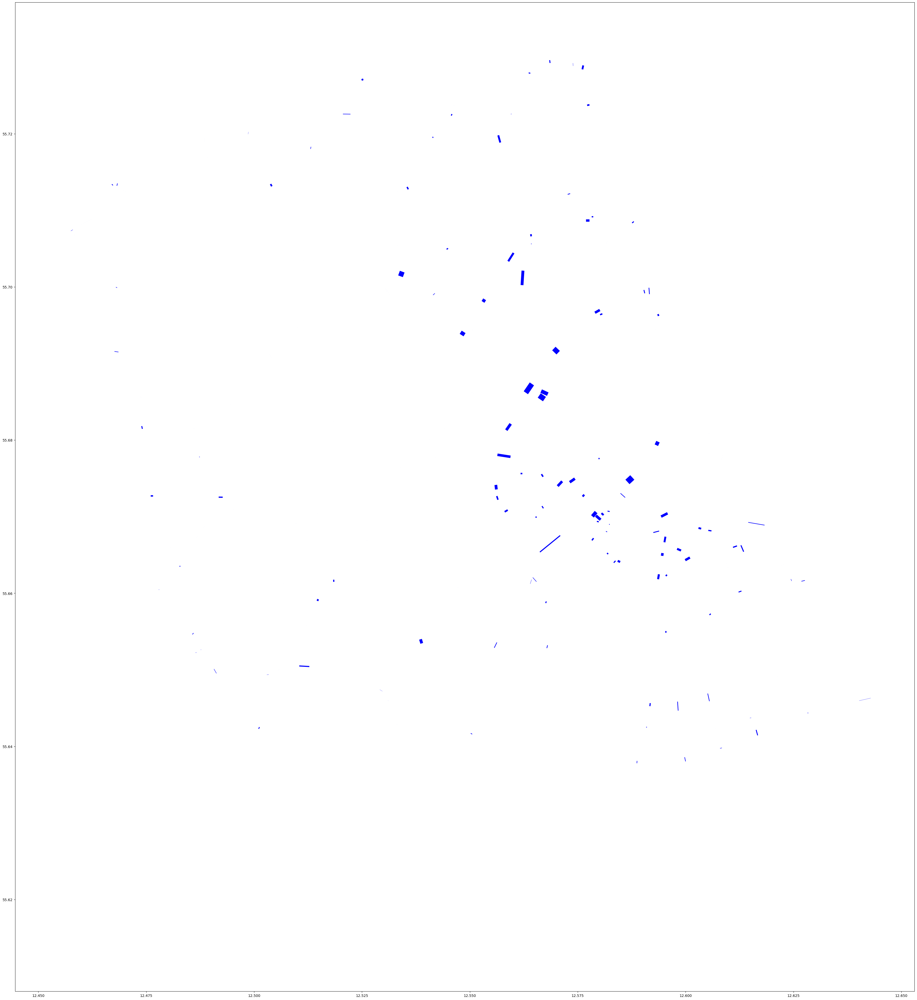

In [338]:
bcount_attr_dict = nx.get_edge_attributes(G_carall, 'bcount_attr')

bcount_attr_dict  = normalise_edge_dict(bcount_attr_dict )

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [1.0 if bcount_attr_dict[k] == 1.0000000000000002 else bcount_attr_dict[k]  for k in bcount_attr_dict]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [bcount_attr_dict[k]*30  for k in bcount_attr_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= 1, linewidth = lc)


plt.show()

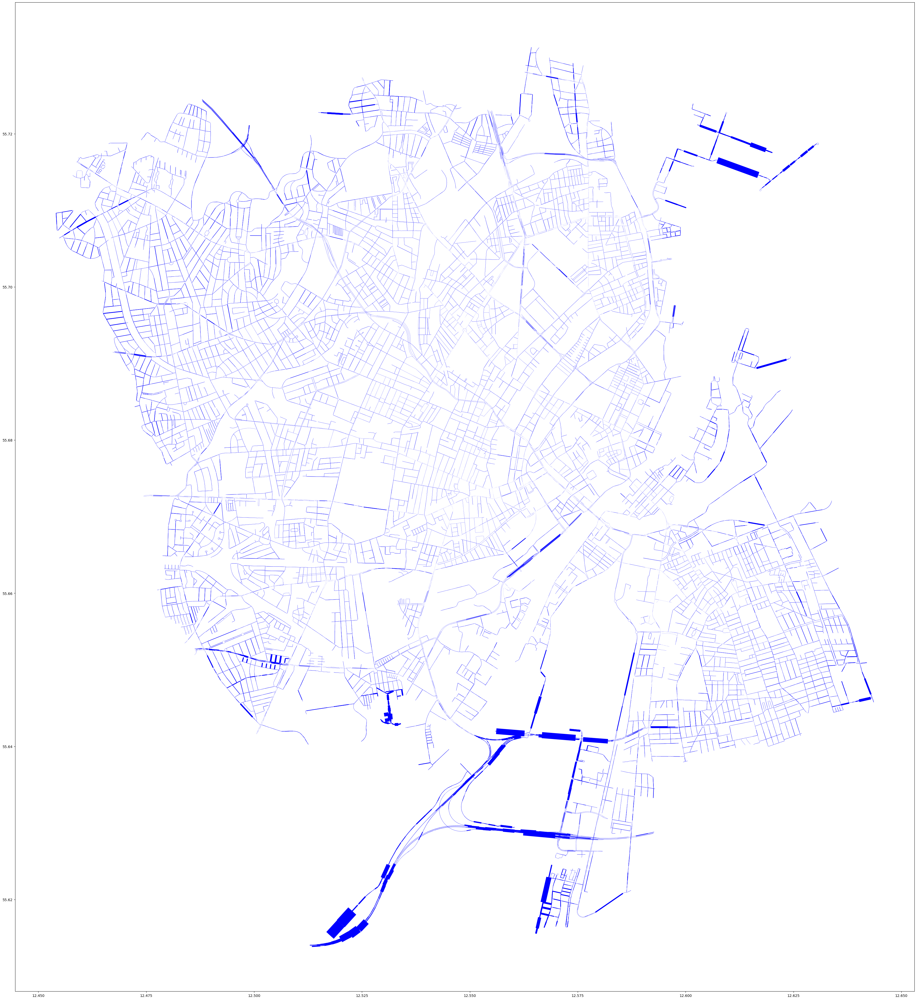

In [339]:
bcount_attr_dict = nx.get_edge_attributes(G_carall, 'bcount_pop_den_attr')

bcount_attr_dict  = normalise_edge_dict(bcount_attr_dict )

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [1.0 if bcount_attr_dict[k] == 1.0000000000000002 else bcount_attr_dict[k]  for k in bcount_attr_dict]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [bcount_attr_dict[k]*30  for k in bcount_attr_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= 1, linewidth = lc)


plt.show()

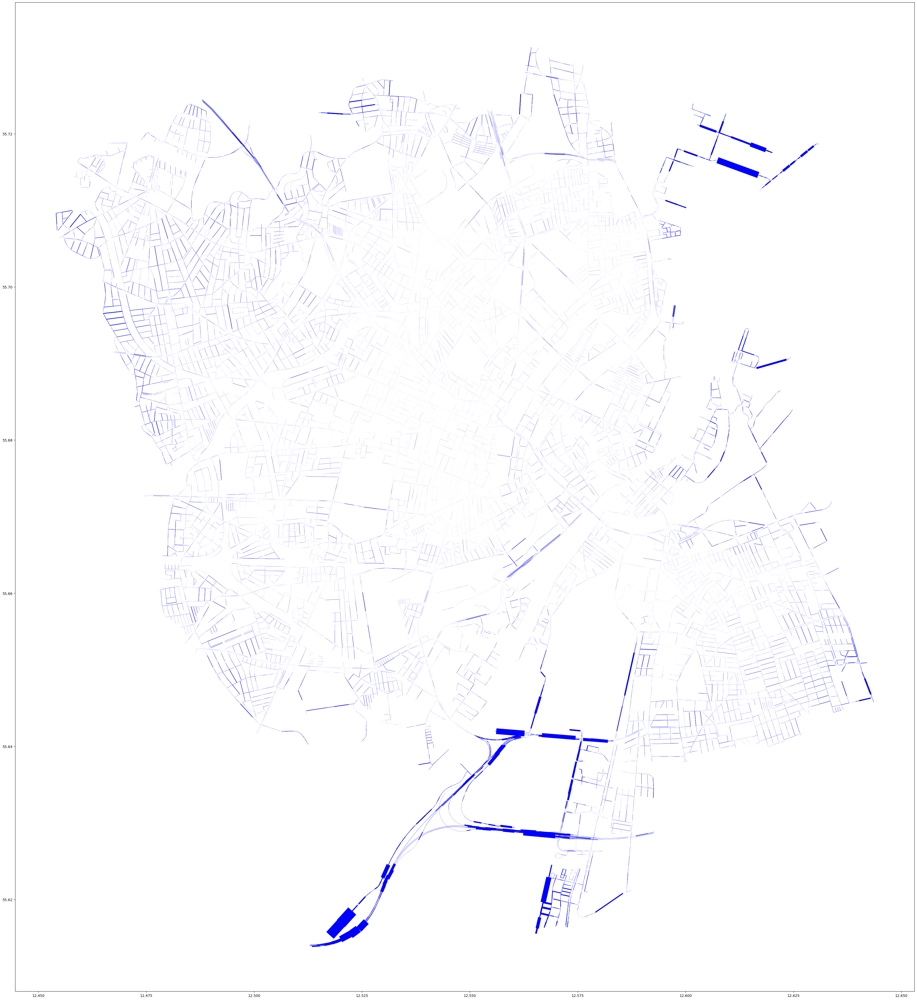

In [340]:
bcount_attr_dict = nx.get_edge_attributes(G_carall, 'pop_den_attr')

bcount_attr_dict  = normalise_edge_dict(bcount_attr_dict )

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [1.0 if bcount_attr_dict[k] == 1.0000000000000002 else bcount_attr_dict[k]  for k in bcount_attr_dict]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [bcount_attr_dict[k]*30  for k in bcount_attr_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= 1, linewidth = lc)


plt.show()

In [14]:
for networktype in networktypes:
    print(networktype)
    i=0
    nDict = {}
    nDict2 = {}
    for i in range(len(pop_den_df)):
        n = ox.distance.get_nearest_node(Gs[networktype], [pop_den_df.iloc[i].lat,pop_den_df.iloc[i].long])
        if haversine([pop_den_df.iloc[i].lat,pop_den_df.iloc[i].long], (Gs[networktype].nodes[n]["y"], Gs[networktype].nodes[n]["x"]), unit="m") <= snapthreshold:
            nDict = {**nDict, n: pop_den_df.iloc[i].pop_den_attr}
            nDict2 = {**nDict2, n: pop_den_df.iloc[i].pop_den}
            i+=1
            print(i) 
            
    nx.set_edge_attributes(Gs[networktype], 0.0, 'pop_den')
    nx.set_edge_attributes(Gs[networktype], 0.0, 'pop_den_attr')
    
    for e in Gs[networktype].edges():
        a,b=e
        lat = Gs[networktype].nodes[a]["y"]
        long = Gs[networktype].nodes[a]["x"]
        eDistDict = {}
        eDistDict2 = {}
    
        for n in nDict2:
            y = Gs[networktype].nodes[n]["y"]
            x = Gs[networktype].nodes[n]["x"]
            dist = haversine([lat,long], (y,x), unit="m")
            eDistDict = {**eDistDict, dist:nDict[n]}
            eDistDict2 = {**eDistDict2, dist:nDict2[n]}
    
        minDist = min(eDistDict.keys())
        minDist2 = min(eDistDict2.keys()) 
        pop_den = eDistDict2[minDist2]
        popDenAttr = eDistDict[minDist]
        edgelength = Gs[networktype].get_edge_data(a,b,0)['length']
        pop_den_attr = popDenAttr * edgelength
        
        nx.set_edge_attributes(Gs[networktype], {(a,b,0): {"pop_den": pop_den }})
        nx.set_edge_attributes(Gs[networktype], {(a,b,0): {"pop_den_attr": pop_den_attr }})
        
    ox_to_csv(Gs[networktype], PATH["data"] + 'copenhagen' + "/", 'copenhagen', networktype)
    ox_to_csv(ox.simplify_graph(Gs[networktype]), PATH["data"] + 'copenhagen' + "/", 'copenhagen', networktype, "_simplified")
    ox.save_graphml(Gs[networktype], "../../bikenwgrowth_external/data/copenhagen/bikedata/G_"+networktype+"_graphml.graphml")
    
        #(distance: (node, pop_den_attr))
        
    

biketrack
53644
53648
53649
53650
53651
53653
53654
53655
54037
54038
54039
54040
54041
54042
54043
54044
54045
54046
54047
54048
54049
54050
54051
54052
54053
54054
54055
54435
54436
54437
54438
54439
54440
54441
54442
54443
54444
54445
54446
54447
54448
54449
54450
54451
54452
54453
54454
54835
54836
54837
54838
54839
54840
54841
54842
54843
54844
54845
54846
54847
54848
54849
54850
54851
54852
54853
55239
55240
55241
55242
55243
55244
55245
55246
55247
55248
55249
55250
55251
55252
55253
55254
55255
55256
55633
55634
55635
55636
55637
55638
55639
55640
55641
55642
55643
55644
55645
55646
55647
55648
55649
55650
55651
55652
55653
56026
56027
56028
56029
56030
56031
56032
56033
56034
56035
56036
56037
56038
56039
56040
56041
56042
56043
56044
56419
56420
56421
56422
56423
56424
56425
56426
56427
56428
56429
56430
56431
56432
56433
56434
56435
56436
56437
56438
56439
56821
56822
56823
56824
56825
56826
56827
56828
56829
56830
56831
56832
56833
56834
56835
56836
56837
56838
56839
56840


In [156]:
L =[53644,
53648,
53649,
53650,
53651,
53653,
53654,
53655,
54037,
54038,
54039,
54040,
54041,
54042,
54043,
54044,
54045,
54046,
54047,
54048,
54049,
54050,
54051,
54052,
54053,
54054,
54055,
54435,
54436,
54437,
54438,
54439,
54440,
54441,
54442,
54443,
54444,
54445,
54446,
54447,
54448,
54449,
54450,
54451,
54452,
54453,
54454,
54835,
54836,
54837,
54838,
54839,
54840,
54841,
54842,
54843,
54844,
54845,
54846,
54847,
54848,
54849,
54850,
54851,
54852,
54853,
55239,
55240,
55241,
55242,
55243,
55244,
55245,
55246,
55247,
55248,
55249,
55250,
55251,
55252,
55253,
55254,
55255,
55256,
55633,
55634,
55635,
55636,
55637,
55638,
55639,
55640,
55641,
55642,
55643,
55644,
55645,
55646,
55647,
55648,
55649,
55650,
55651,
55652,
55653,
56026,
56027,
56028,
56029,
56030,
56031,
56032,
56033,
56034,
56035,
56036,
56037,
56038,
56039,
56040,
56041,
56042,
56043,
56044,
56419,
56420,
56421,
56422,
56423,
56424,
56425,
56426,
56427,
56428,
56429,
56430,
56431,
56432,
56433,
56434,
56435,
56436,
56437,
56438,
56439,
56821,
56822,
56823,
56824,
56825,
56826,
56827,
56828,
56829,
56830,
56831,
56832,
56833,
56834,
56835,
56836,
56837,
56838,
56839,
56840,
57223,
57224,
57225,
57226,
57227,
57228,
57229,
57230,
57231,
57232,
57233,
57234,
57235,
57236,
57237,
57238,
57239,
57240,
57241,
57242,
57243,
57623,
57624,
57625,
57626,
57627,
57628,
57629,
57630,
57631,
57632,
57633,
57634,
57635,
57636,
57637,
57638,
57639,
57640,
57641,
57642,
58024,
58025,
58026,
58027,
58028,
58029,
58030,
58031,
58032,
58033,
58034,
58035,
58036,
58037,
58038,
58438,
58439,
58440,
58441,
58442,
58850,
58851,
58852,
58855,
58856,
58857,
58858,
58859,
59271,
59272,
59273,
59274,
59278]

In [173]:
LL = pd.DataFrame({'popdens':  [pop_den_df['pop_den'][i] for i in L]})

In [192]:
[pop_den_df.iloc[i] for i in L]

[long                                              12.494583
 lat                                                55.72875
 pop_den                                          2697.29126
 pop_den_attr                                       0.000371
 geometry        POINT (12.49458328424724 55.72874995923848)
 Name: 53644, dtype: object,
 long                                              12.527917
 lat                                                55.72875
 pop_den                                         4757.211914
 pop_den_attr                                        0.00021
 geometry        POINT (12.52791661744724 55.72874995923848)
 Name: 53648, dtype: object,
 long                                               12.53625
 lat                                                55.72875
 pop_den                                         2580.804199
 pop_den_attr                                       0.000387
 geometry        POINT (12.53624995074724 55.72874995923848)
 Name: 53649, dtype: object

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


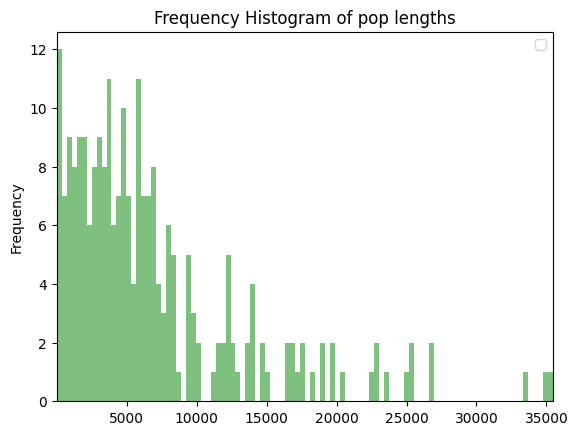

In [176]:
df_to_histogram(LL['popdens'], "pop lengths")

In [178]:
min(LL['popdens'])

2.800030708312988

In [180]:
max(LL['popdens'])

35463.50390625

In [182]:
LL['popdens'].describe()


count      239.000000
mean      6893.590795
std       6617.669384
min          2.800031
25%       2460.734131
50%       5002.032227
75%       8304.763672
max      35463.503906
Name: popdens, dtype: float64

LL['popdens'].describe()

In [172]:
[pop_den_df['pop_den'][i] for i in LL]

KeyError: 'popdens'

In [168]:
LL =

KeyError: 'popdens'

In [165]:
LL['popdens']

Series([], Name: popdens, dtype: float64)

In [166]:
pop_den_df[0].pop_den

KeyError: 0

# Calculate betweenness centrality for length_attr

In [15]:
G_carall = copy.deepcopy(Gs['carall'])

In [16]:
#Load bike data
count_df = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/bikedata/bicycle_counts.csv")
count_df = count_df[count_df.year ==2019]
bikelanes = gpd.GeoDataFrame(count_df, geometry=gpd.points_from_xy(count_df['long'], count_df['lat']))

#convert to fraction. All bikecounts are added 1 to avoid division by zero (if zero bikes).
count_df['bcount_attr']= count_df['bicycle_count']
for i in range(len(count_df)):
    count_df['bcount_attr'].iloc[i] = 1.0/float(count_df['bicycle_count'].iloc[i]+1)

/var/folders/r8/tq2ln28d2vg5b08rjdywrcvc0000gn/T/ipykernel_956/525113933.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  count_df['bcount_attr'].iloc[i] = 1.0/float(count_df['bicycle_count'].iloc[i]+1)


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


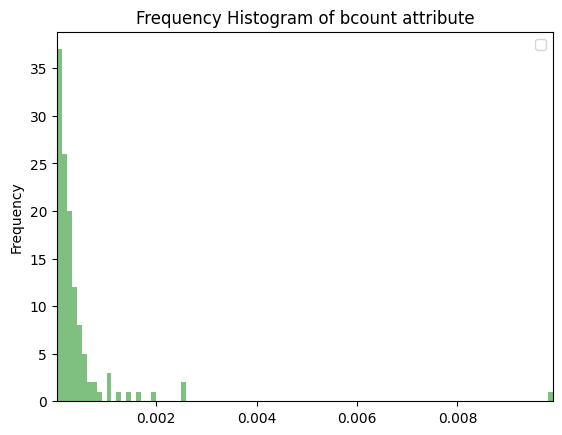

In [17]:
df_to_histogram(count_df['bcount_attr'], 'bcount attribute')

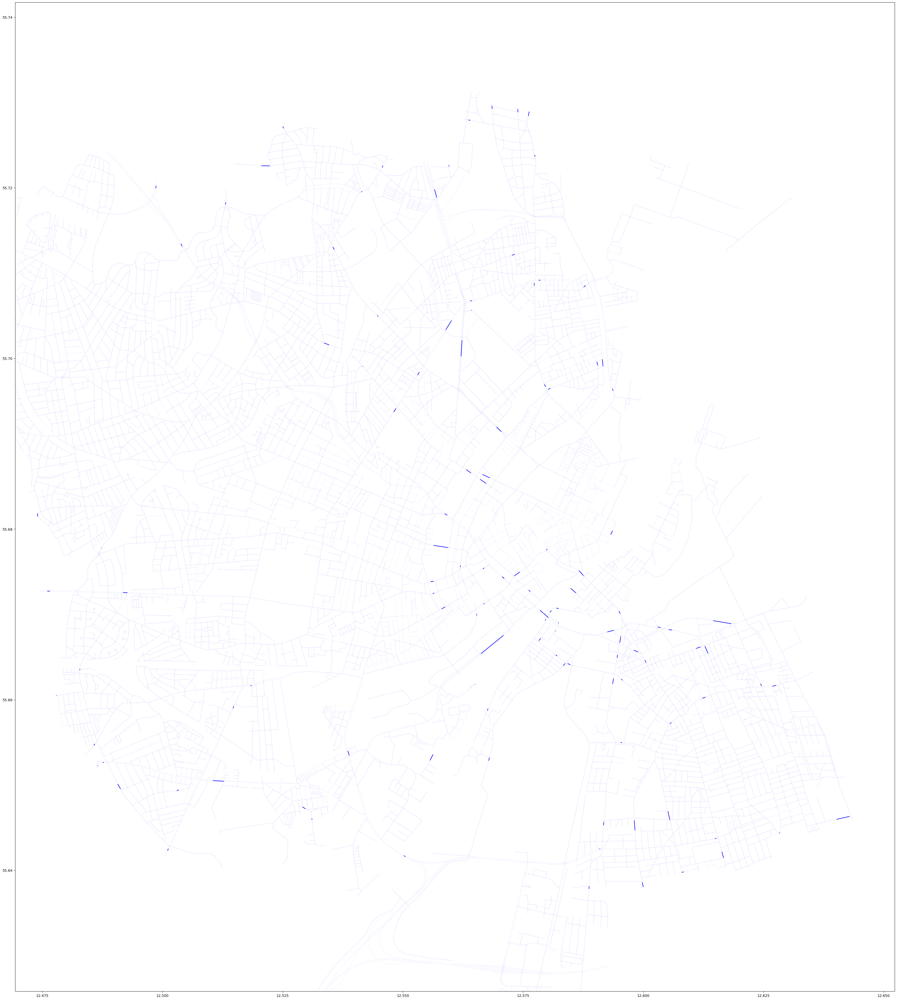

In [235]:
bcount_dictt = nx.get_edge_attributes(G_carall, "bcount")
bcount_unassigned = count_df['bicycle_count'].mean()

lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

ac = [0.04 if (bcount_dictt[k]) == 0 else 1.0 for k in bcount_dictt]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac)
#bikelanes2.plot(ax=ax, color='red', alpha = 0.3,linestyle=(0,(5,10)))



plt.axis([12.469380, 12.652281, 55.625802, 55.741728])


plt.show()

In [247]:
bcount_dictt_norm = normalise_edge_dict(bcount_dictt)

In [267]:
bcount_dict_one=bcount_dictt_norm

In [269]:
bcount_dict_one

{(118725, 2512504197, 0): 0.0,
 (118725, 298795891, 0): 0.0,
 (118730, 1051183834, 0): 0.0,
 (118731, 1051183809, 0): 0.0,
 (118732, 6534097568, 0): 0.0,
 (118732, 283603631, 0): 0.0,
 (118733, 4924695578, 0): 0.0,
 (118735, 8977396171, 0): 0.0,
 (118735, 4393215585, 0): 0.0,
 (118737, 2935851405, 0): 0.0,
 (118738, 1051990746, 0): 0.0,
 (118739, 588481105, 0): 0.0,
 (118747, 6651812229, 0): 0.0,
 (118747, 1052455426, 0): 0.0,
 (118748, 1051183765, 0): 0.0,
 (118749, 1052455244, 0): 0.0,
 (118750, 1052455372, 0): 0.0,
 (118751, 3574460115, 0): 0.0,
 (118751, 6651812218, 0): 0.0,
 (118751, 118747, 0): 0.0,
 (118752, 1052455274, 0): 0.0,
 (118753, 7640808912, 0): 0.0,
 (118754, 1052455228, 0): 0.0,
 (118755, 1052455297, 0): 0.0,
 (118756, 311364393, 0): 0.0,
 (118757, 1052455357, 0): 0.0,
 (118759, 1052455428, 0): 0.0,
 (118760, 1052455289, 0): 0.0,
 (118761, 1052455238, 0): 0.0,
 (118762, 1052455202, 0): 0.0,
 (118763, 118764, 0): 0.0,
 (118763, 5887571943, 0): 0.0,
 (118764, 4225294594

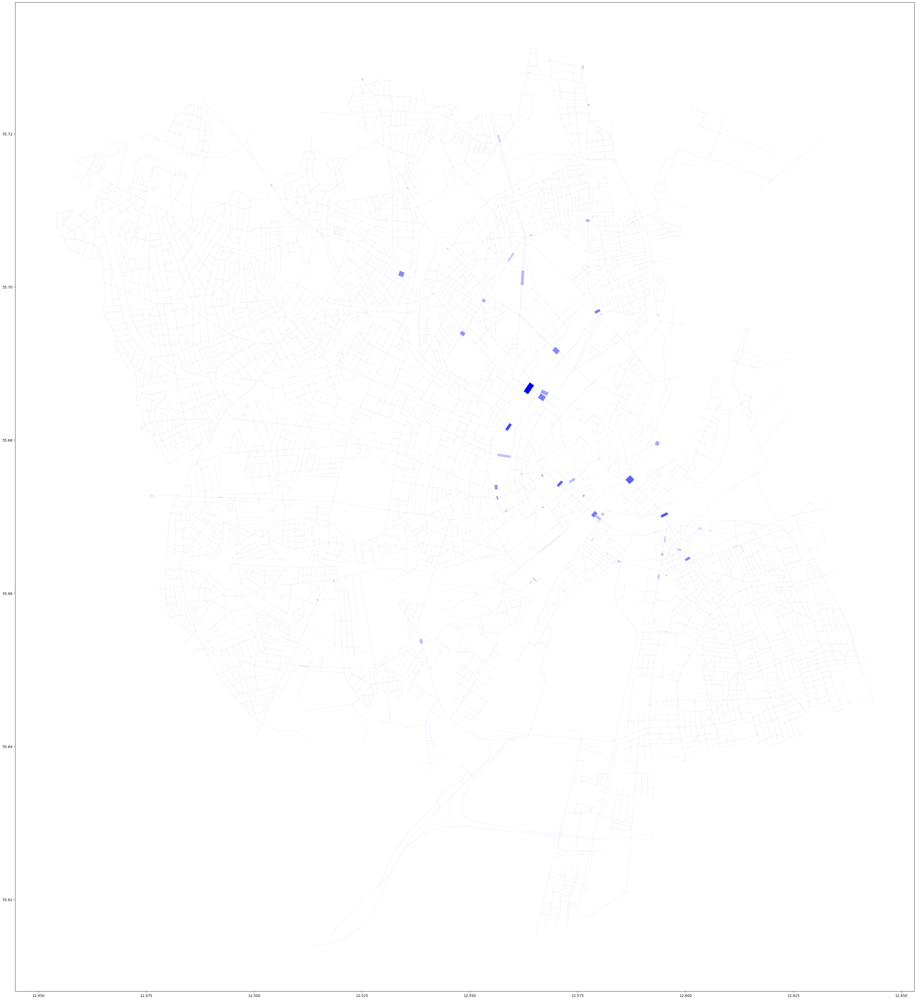

In [275]:
#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [ 0.1 if (bcount_dict_one[k] == 0.0) else bcount_dict_one[k] for k in bcount_dict_one]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [0.38 if bcount_dict_one[k]==0 else bcount_dict_one[k]*30 for k in bcount_dict_one]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

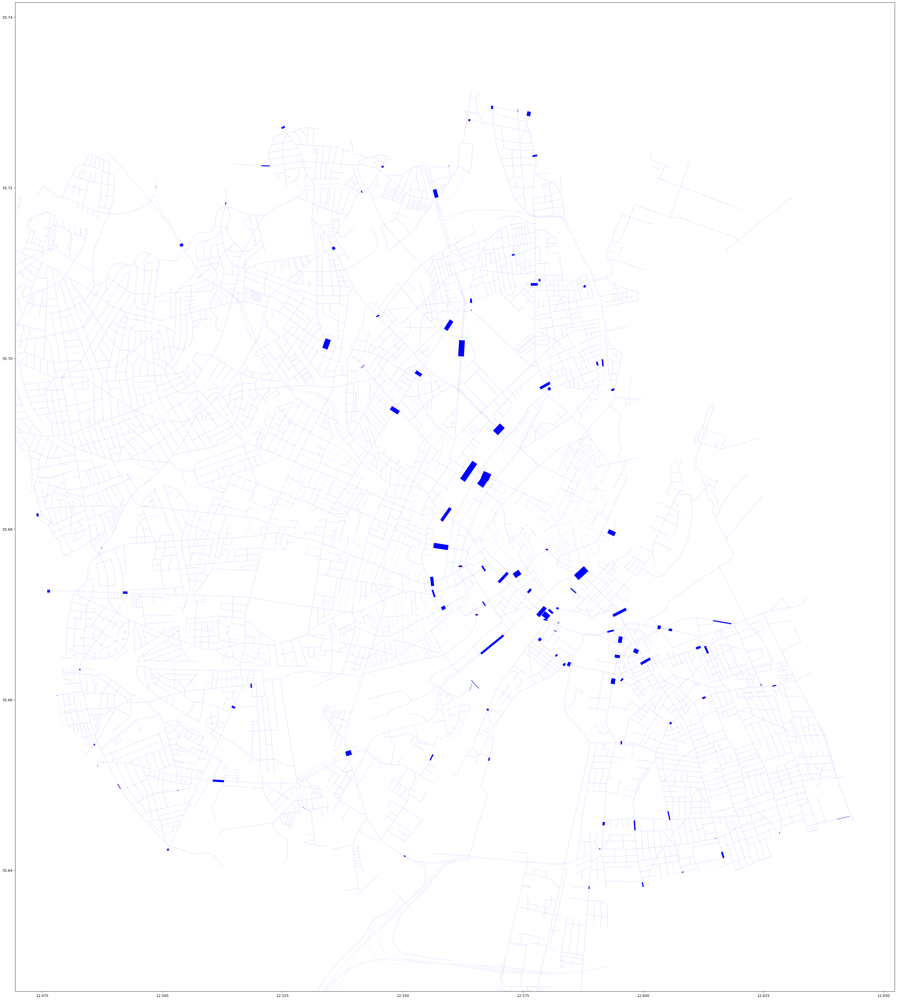

In [250]:
bcount_dictt = nx.get_edge_attributes(G_carall, "bcount")
bcount_unassigned = count_df['bicycle_count'].mean()

lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

ac = [0.04 if (bcount_dictt[k]) == 0 else 1.0 for k in bcount_dictt]



lc = [2.0 if (bcount_dictt[k]) == 0 else bcount_dictt[k]/700 for k in bcount_dictt]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac,linewidth = lc)
#bikelanes2.plot(ax=ax, color='red', alpha = 0.3,linestyle=(0,(5,10)))



plt.axis([12.469380, 12.652281, 55.625802, 55.741728])


plt.show()

# Apply only bcount


In [ ]:
#We create a variable for unassigned edges, 
# which is the average edgelength multiplied with the average fraction of bikecounts in the network
G_carall = ox.load_graphml('../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml')

bcount_unassigned = count_df['bicycle_count'].mean()

nx.set_edge_attributes(G_carall, 0.0, 'bcount')

for i in range(len(count_df)):
    ne = ox.distance.get_nearest_edge(G_carall, [count_df.iloc[i].lat,count_df.iloc[i].long])
    nx.set_edge_attributes(G_carall, {ne: {'bcount': count_df.iloc[i].bicycle_count }})
    
bcount_dict = nx.get_edge_attributes(G_carall, "bcount")

ox_to_csv(G_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(G_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")


with zipfile.ZipFile("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.zip", 'r') as zip_ref:
    zip_ref.extractall("../../bikenwgrowth_external/data/copenhagen/")

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

GG_carall = copy.deepcopy(G_carall)

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

#We take only assigned edges
edges1 = edges[edges.bcount !=0.0]

#we remove unnecessery data

edges2 = edges1

#we apply the mean of bikecounts for all assigned streets, by grouping on the street name and calculating the mean.
edges3 = edges2.groupby('name')['bcount'].mean().to_frame()

#renaming this column
edges3 = edges3.rename(columns={"bcount": "mean_group_bcount"})

#the initial edges are joined with the new generalised counts
result = pd.merge(edges,edges3,on='name',how = 'left')

result.to_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

compress_file("../../bikenwgrowth_external/data/copenhagen/","copenhagen_carall_edges")

result2 = result

#we apply the 'bcount_attr' the the result2 dataframe, representing all edges in the carall network.
# for edges that 'still' do not have a bikecount, a standard value is assigned 'bcount_attr_unassigned',
# otherwise the new mean fraction of bikecounts for each edge, is multiplied with the length of this edge.
# For now we lost the original fraction of bikecounts for assigned edges, but we will add them back in next step.
for i in range(len(result2)):
    num = result2['mean_group_bcount'].iloc[i]
    #if num is NaN
    if num != num:
        result2['mean_group_bcount'].iloc[i]= bcount_unassigned
    else:
        result2['mean_group_bcount'].iloc[i]= num 

# The new results are added to the carall network,
i=-1
for e in GG_carall.edges():
    i+=1
    a,b=e
    old_bcount = GG_carall.get_edge_data(a,b,0)['bcount']
    # if the edge is initially unassigned in the network we check if a generalised mean value of the whole street, 
    #belonging to this street exist, otherwise a standard value is given. If an edge is initially assigned a bikecount
    # we assign it the bcount_attr again, represented as edgelength multiplied by the fraction of bikecounts.
    if old_bcount ==0.0:
        if  result2['mean_group_bcount'].iloc[i] == bcount_unassigned:
            nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount": bcount_unassigned }})
        else:
            mean_group_count = result2['mean_group_bcount'].iloc[i]
            nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount": mean_group_count }})
    else:
        nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount": old_bcount }})

bcount_dict = nx.get_edge_attributes(GG_carall, "bcount")

bcount_mean = statistics.mean([float(k) for k in bcount_dict.values()])

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/mean_bcount.pkl', 'wb') as f:
    pickle.dump(bcount_mean, f)


ox_to_csv(GG_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(GG_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

ox.save_graphml(GG_carall, "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/edges_dict_bcount.pkl', 'wb') as f:
    pickle.dump(bcount_dict, f)




In [305]:
bcount_dictt = normalise_edge_dict(bcount_dict.copy())

In [315]:
bcount_dict

{(118725, 2512504197, 0): 7398.373983739837,
 (118725, 298795891, 0): 13650.0,
 (118730, 1051183834, 0): 7398.373983739837,
 (118731, 1051183809, 0): 4100.0,
 (118732, 6534097568, 0): 7398.373983739837,
 (118732, 283603631, 0): 7398.373983739837,
 (118733, 4924695578, 0): 7398.373983739837,
 (118735, 8977396171, 0): 7398.373983739837,
 (118735, 4393215585, 0): 4100.0,
 (118737, 2935851405, 0): 7398.373983739837,
 (118738, 1051990746, 0): 7398.373983739837,
 (118739, 588481105, 0): 7398.373983739837,
 (118747, 6651812229, 0): 22100.0,
 (118747, 1052455426, 0): 7398.373983739837,
 (118748, 1051183765, 0): 7398.373983739837,
 (118749, 1052455244, 0): 7398.373983739837,
 (118750, 1052455372, 0): 7398.373983739837,
 (118751, 3574460115, 0): 7398.373983739837,
 (118751, 6651812218, 0): 7398.373983739837,
 (118751, 118747, 0): 22100.0,
 (118752, 1052455274, 0): 7398.373983739837,
 (118753, 7640808912, 0): 7398.373983739837,
 (118754, 1052455228, 0): 7398.373983739837,
 (118755, 1052455297, 0)

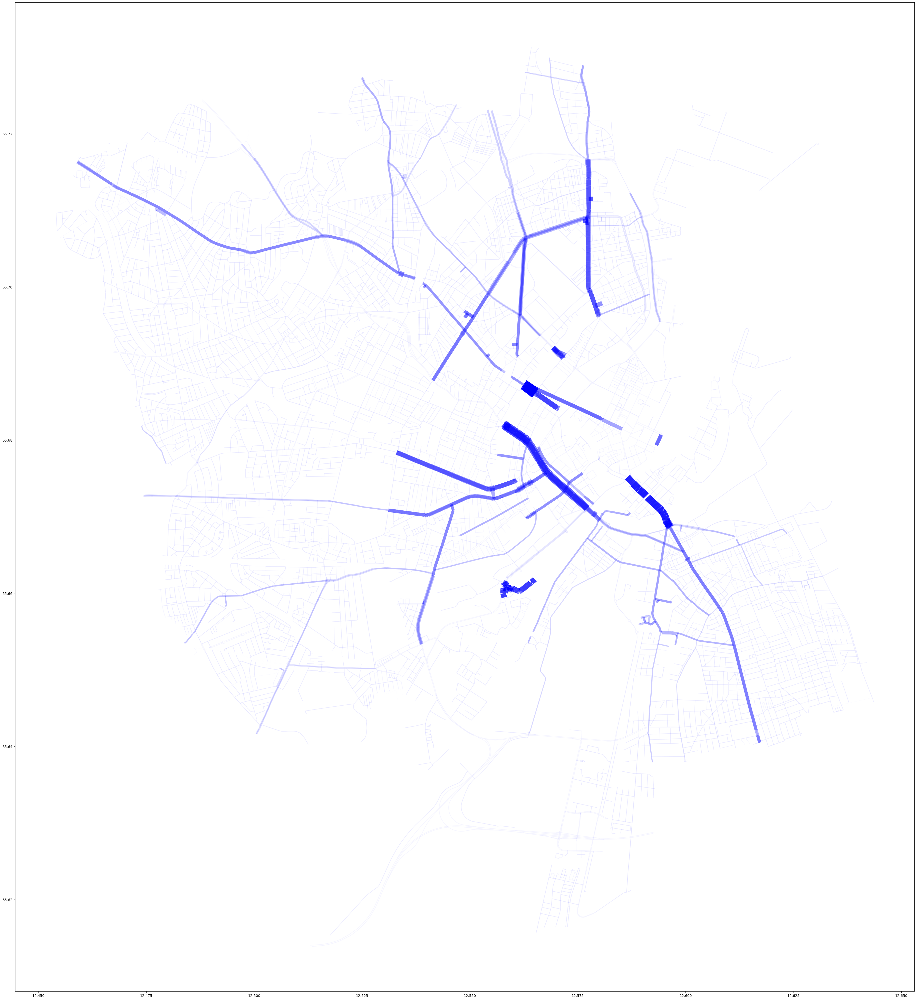

In [312]:
#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [ 0.04 if bcount_dictt[k] == 0.17367075079201497 else bcount_dictt[k]  for k in bcount_dictt]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [bcount_dictt[k]*30 if (bcount_dictt[k] != 0.17367075079201497) else 1.5 for k in bcount_dictt]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [ ]:
poplanes_cph.crs = "EPSG:4326"

norm = matplotlib.colors.LogNorm(vmin=poplanes_cph.pop_den.min()*5, vmax=poplanes_cph.pop_den.max())
fig = poplanes_cph.plot("pop_den", 
                                   figsize=(20, 11),
            
                                   legend=True,
                     
                        markersize=400,
                                   norm=norm);
fig.set_xlim(12.469380, 12.652281)
fig.set_ylim(55.625802, 55.741728)

ax = fig

lanes.plot(ax=ax, marker='x', color='black', linewidth = 1, alpha = 0.1)


#norm2 =  matplotlib.colors.LogNorm(vmin=bikelanes.bicycle_count.min(), vmax=bikelanes.bicycle_count.max())


#import contextily as ctx
#ax = fig
#bikelanes.plot(ax=ax, marker= "s")

#plt.axis([12.469380, 12.652281, 55.625802, 55.741728])
#plt.show()

#ctx.add_basemap(
#    ax,
    # CRS definition. Without the line below, the map stops making sense
 #   crs='epsg:4326',
#)

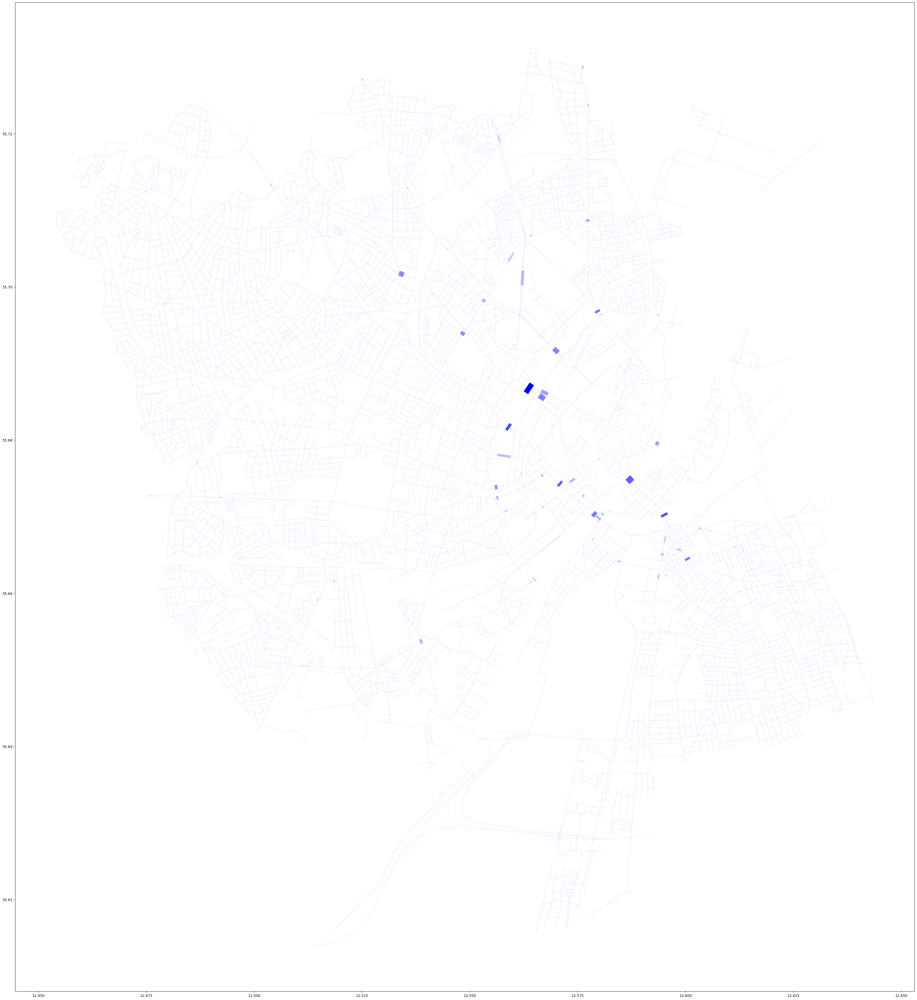

In [313]:
#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [ 0.04 if (bcount_dict_one[k] == 0.0) else bcount_dict_one[k] for k in bcount_dict_one]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [1.5 if bcount_dict_one[k]==0 else bcount_dict_one[k]*30 for k in bcount_dict_one]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [294]:
with zipfile.ZipFile("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.zip", 'r') as zip_ref:
    zip_ref.extractall("../../bikenwgrowth_external/data/copenhagen/")

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

In [314]:
edges[edges['name'] == 'Amagerfælledvej']['bcount'].unique()

array([ 8600.,  7600., 10100.,  8100.])

copenhagen: Successfully wrote graph carall
copenhagen: Successfully wrote graph carall_simplified


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


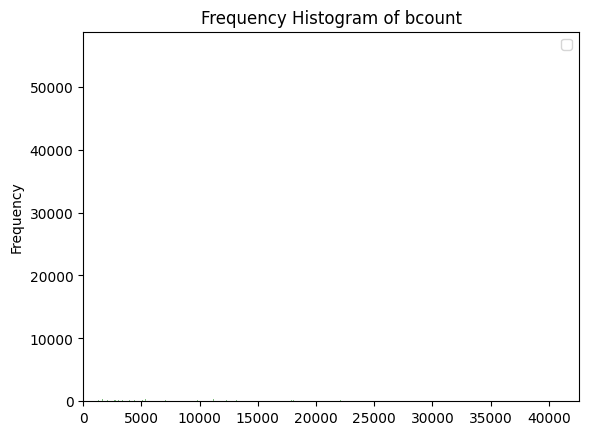

In [224]:
lanes = ox.graph_to_gdfs(GG_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

ac = [0.04 if (bcount_dict[k]) == bcount_unassigned else 1.0 for k in bcount_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac)
#bikelanes2.plot(ax=ax, color='red', alpha = 0.3,linestyle=(0,(5,10)))



plt.axis([12.469380, 12.652281, 55.625802, 55.741728])


plt.show()

In [230]:
bcc = pd.DataFrame({'bc' : list(bcount_dict.values())})
df_to_histogram(bcc['bc'],"bc")

In [1]:
count_df['pop_den']

NameError: name 'count_df' is not defined

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


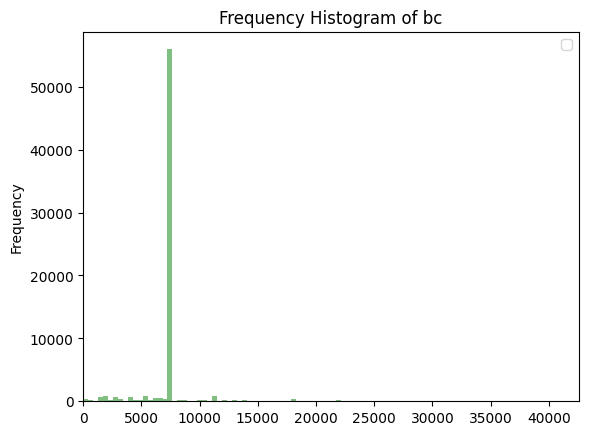

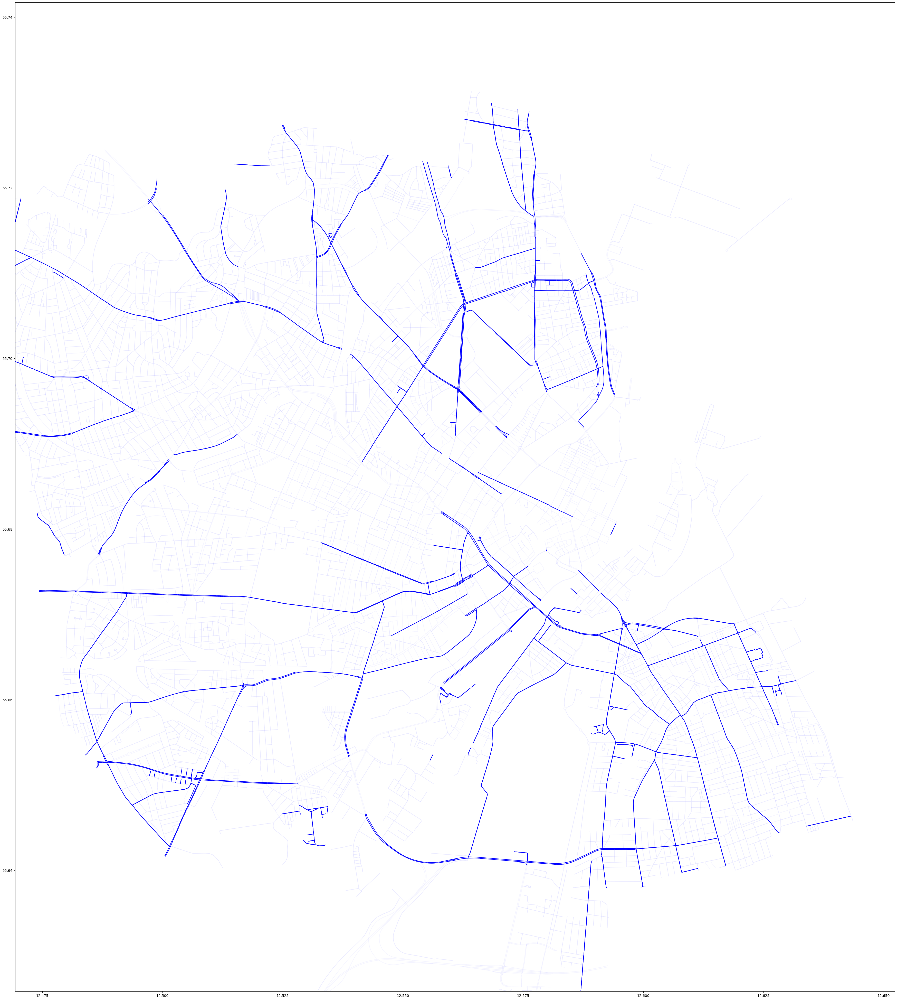

In [225]:
lanes = ox.graph_to_gdfs(GG_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

ac = [0.04 if (bcount_dict[k]) == bcount_unassigned else 1.0 for k in bcount_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac)
#bikelanes2.plot(ax=ax, color='red', alpha = 0.3,linestyle=(0,(5,10)))



plt.axis([12.469380, 12.652281, 55.625802, 55.741728])


plt.show()

In [251]:
blist = list(bcount_dict.values())

In [258]:
blist[9]

7398.373983739837

In [263]:
lll = []
for i in range(len(blist)):
    if blist[i] != 7398.373983739837:
        lll.append(blist[i])

In [265]:
len(lll)

10329

In [266]:
len(blist)

66053

In [260]:
[blist[x] for x in blist if (blist[x] !=7398.373983739837)]

TypeError: list indices must be integers or slices, not numpy.float64

# bcount attr

In [146]:
count_df['bicycle_count'].mean()

7398.373983739837

In [147]:
min(count_df['bicycle_count'])

100

In [148]:
max(count_df['bicycle_count'])

42600

In [18]:
#We create a variable for unassigned edges, 
# which is the average edgelength multiplied with the average fraction of bikecounts in the network

mean_bcount_attr = count_df['bcount_attr'].mean()

edges_len_dict = nx.get_edge_attributes(G_carall, 'length')
edges_len_mean = statistics.mean([k for k in edges_len_dict.values()])

bcount_attr_unassigned = edges_len_mean*mean_bcount_attr

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/unassigned_bcount_attr.pkl', 'wb') as f:
    pickle.dump(bcount_attr_unassigned, f)


bcount_attr_unassigned

#we set the bcount_attr to 0 initially

nx.set_edge_attributes(G_carall, 0.0, 'bcount_attr')

#We apply bikecounts from our data to the nearest edges in the carall network
for i in range(len(count_df)):
    ne = ox.distance.get_nearest_edge(G_carall, [count_df.iloc[i].lat,count_df.iloc[i].long])
    nx.set_edge_attributes(G_carall, {ne: {'bcount_attr': count_df.iloc[i].bcount_attr }})

    
# a dictionary of each of the two new attributes in the G_carall graph is generated and saved. 
bcount_attr_dict = nx.get_edge_attributes(G_carall, "bcount_attr")

ox_to_csv(G_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(G_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

copenhagen: Successfully wrote graph carall
copenhagen: Successfully wrote graph carall_simplified


In [19]:
with zipfile.ZipFile("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.zip", 'r') as zip_ref:
    zip_ref.extractall("../../bikenwgrowth_external/data/copenhagen/")

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

GG_carall = copy.deepcopy(G_carall)

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

#We take only assigned edges
edges1 = edges[edges.bcount_attr !=0.0]

#we remove unnecessery data
edges2 = edges1.drop(edges1.columns[[1,3,4,5,6,8,9,10,11,12,13,14,15,16,17,18]], axis=1)

edges2 = edges1

#we apply the mean of bikecounts for all assigned streets, by grouping on the street name and calculating the mean.
edges3 = edges2.groupby('name')['bcount_attr'].mean().to_frame()

#renaming this column
edges3 = edges3.rename(columns={"bcount_attr": "mean_group_bcount"})

#the initial edges are joined with the new generalised counts
result = pd.merge(edges,edges3,on='name',how = 'left')

result.to_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

compress_file("../../bikenwgrowth_external/data/copenhagen/","copenhagen_carall_edges")

/var/folders/r8/tq2ln28d2vg5b08rjdywrcvc0000gn/T/ipykernel_956/1317401030.py:4: DtypeWarning: Columns (13,16) have mixed types. Specify dtype option on import or set low_memory=False.
  edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")
/var/folders/r8/tq2ln28d2vg5b08rjdywrcvc0000gn/T/ipykernel_956/1317401030.py:8: DtypeWarning: Columns (13,16) have mixed types. Specify dtype option on import or set low_memory=False.
  edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")


In [20]:
result2 = result

#we apply the 'bcount_attr' the the result2 dataframe, representing all edges in the carall network.
# for edges that 'still' do not have a bikecount, a standard value is assigned 'bcount_attr_unassigned',
# otherwise the new mean fraction of bikecounts for each edge, is multiplied with the length of this edge.
# For now we lost the original fraction of bikecounts for assigned edges, but we will add them back in next step.
for i in range(len(result2)):
    num = result2['mean_group_bcount'].iloc[i]
    #if num is NaN
    if num != num:
        result2['mean_group_bcount'].iloc[i]= bcount_attr_unassigned
    else:
        result2['mean_group_bcount'].iloc[i]= num *result2['length'].iloc[i]

# The new results are added to the carall network,
i=-1
for e in GG_carall.edges():
    i+=1
    a,b=e
    old_bcount_attr = GG_carall.get_edge_data(a,b,0)['bcount_attr']
    # if the edge is initially unassigned in the network we check if a generalised mean value of the whole street, 
    #belonging to this street exist, otherwise a standard value is given. If an edge is initially assigned a bikecount
    # we assign it the bcount_attr again, represented as edgelength multiplied by the fraction of bikecounts.
    if old_bcount_attr ==0.0:
        if  result2['mean_group_bcount'].iloc[i] == bcount_attr_unassigned:
            nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount_attr": bcount_attr_unassigned }})
        else:
            edgelength = GG_carall.get_edge_data(a,b,0)['length']
            mean_group_count = result2['mean_group_bcount'].iloc[i]
            nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount_attr": mean_group_count }})
    else:
        edgelength = GG_carall.get_edge_data(a,b,0)['length']
        bcountattr = old_bcount_attr* edgelength
        nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount_attr": bcountattr }})

/var/folders/r8/tq2ln28d2vg5b08rjdywrcvc0000gn/T/ipykernel_956/587998049.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  result2['mean_group_bcount'].iloc[i]= bcount_attr_unassigned
/var/folders/r8/tq2ln28d2vg5b08rjdywrcvc0000gn/T/ipykernel_956/587998049.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  result2['mean_group_bcount'].iloc[i]= num *result2['length'].iloc[i]


copenhagen: Successfully wrote graph carall
copenhagen: Successfully wrote graph carall_simplified


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


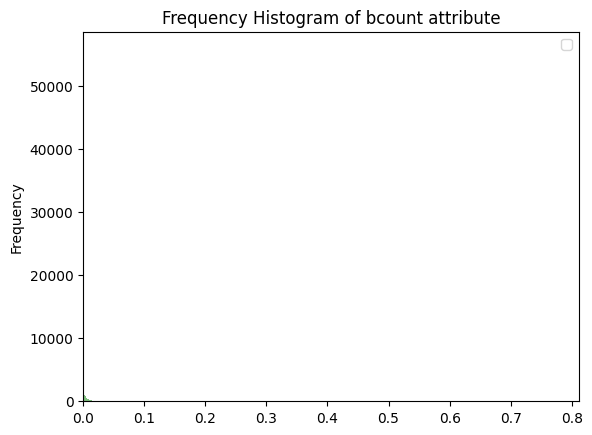

In [21]:
bcount_attr_dict = nx.get_edge_attributes(GG_carall, "bcount_attr")
bcount_attr_mean = statistics.mean([k for k in bcount_attr_dict.values()])

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/mean_bcount_attr.pkl', 'wb') as f:
    pickle.dump(bcount_attr_mean, f)


ox_to_csv(GG_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(GG_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

ox.save_graphml(GG_carall, "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/edges_dict_bcount_attr.pkl', 'wb') as f:
    pickle.dump(bcount_attr_dict, f)



dict_to_histogram(bcount_attr_dict, "bcount attribute")

/Users/Kristof/opt/anaconda3/envs/OSMNX/lib/python3.8/site-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


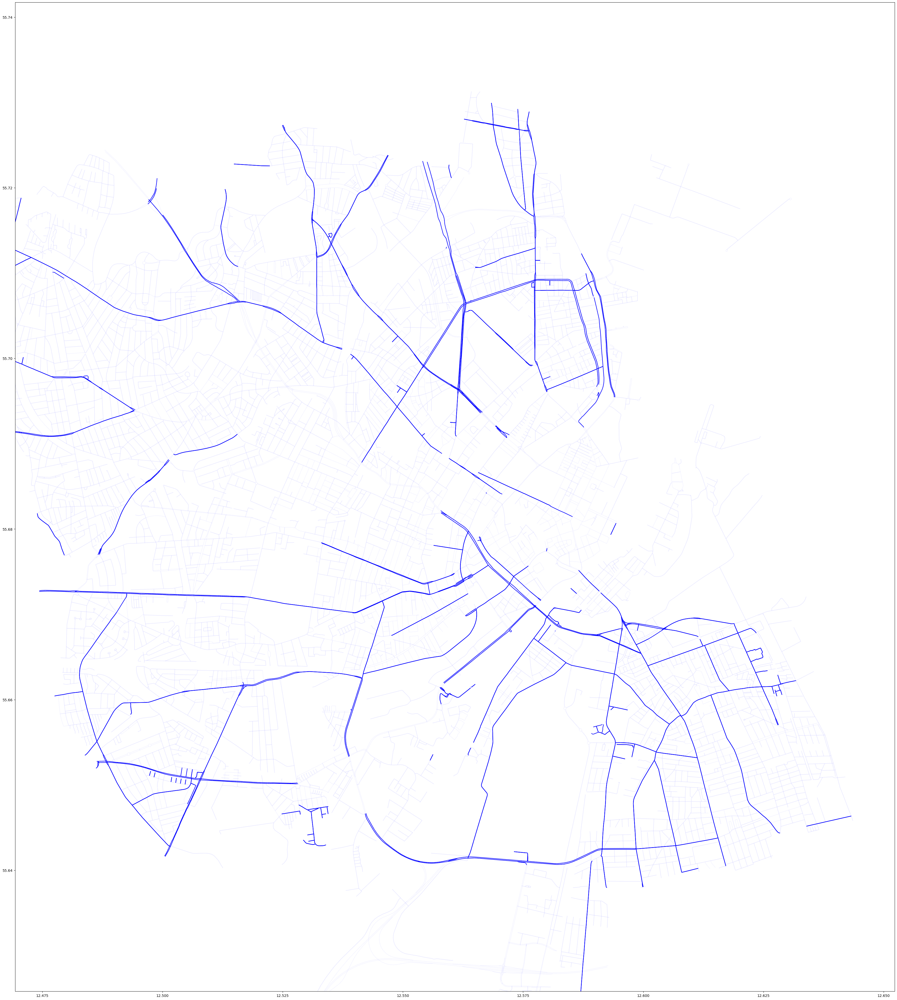

In [22]:
lanes = ox.graph_to_gdfs(GG_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

ac = [0.04 if (bcount_attr_dict[k]) == bcount_attr_unassigned else 1.0 for k in bcount_attr_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac)
#bikelanes2.plot(ax=ax, color='red', alpha = 0.3,linestyle=(0,(5,10)))



plt.axis([12.469380, 12.652281, 55.625802, 55.741728])


plt.show()

In [52]:
bcount_attr_dict


{(118725, 2512504197, 0): 0.01255409547277127,
 (118725, 298795891, 0): 0.002301442409154617,
 (118730, 1051183834, 0): 0.01255409547277127,
 (118731, 1051183809, 0): 0.004963423555229292,
 (118732, 6534097568, 0): 0.01255409547277127,
 (118732, 283603631, 0): 0.01255409547277127,
 (118733, 4924695578, 0): 0.01255409547277127,
 (118735, 8977396171, 0): 0.01255409547277127,
 (118735, 4393215585, 0): 0.002793952694464123,
 (118737, 2935851405, 0): 0.01255409547277127,
 (118738, 1051990746, 0): 0.01255409547277127,
 (118739, 588481105, 0): 0.01255409547277127,
 (118747, 6651812229, 0): 0.0004987557124112031,
 (118747, 1052455426, 0): 0.01255409547277127,
 (118748, 1051183765, 0): 0.01255409547277127,
 (118749, 1052455244, 0): 0.01255409547277127,
 (118750, 1052455372, 0): 0.01255409547277127,
 (118751, 3574460115, 0): 0.01255409547277127,
 (118751, 6651812218, 0): 0.01255409547277127,
 (118751, 118747, 0): 0.0007515497036333198,
 (118752, 1052455274, 0): 0.01255409547277127,
 (118753, 764

In [23]:
G_carall = copy.deepcopy(GG_carall)

In [24]:
with open("../../bikenwgrowth_external/data/copenhagen/bikedata/mean_pop_den_attr.pkl", 'rb') as f:
    mean_pop_den_attr = pickle.load(f)
with open("../../bikenwgrowth_external/data/copenhagen/bikedata/mean_bcount_attr.pkl", 'rb') as q:
    mean_bcount_attr = pickle.load(q)

## Set alpha

a = 0.5

unassigned_bcount_pop_den_attr = (a* mean_bcount_attr) + ((1-a)* mean_pop_den_attr)

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/unassigned_bcount_pop_den_attr.pkl', 'wb') as f:
    pickle.dump(unassigned_bcount_pop_den_attr, f)

## Add 'bcount_pop_den_attr' to carall graph

nx.set_edge_attributes(G_carall, 0.0, 'bcount_pop_den_attr')

ox_to_csv(G_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(G_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

ox.save_graphml(G_carall, "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")

with zipfile.ZipFile("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.zip", 'r') as zip_ref:
    zip_ref.extractall("../../bikenwgrowth_external/data/copenhagen/")

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

edges

## Calculate 'bcount_pop_den_attr' for each edge, and add to carall graph

#edges = edges.drop(edges.columns[[0,1,2,3,4,5,6,9,10,11,12,13,14,15,16,17,18,19,20,21]], axis=1)

edges['bcount_pop_den_attr'] = a* edges['bcount_attr'] + (1-a)*edges['pop_den_attr']
#edges['bcount_attr'] * edges['pop_den_attr']

edges

i=-1
for e in G_carall.edges():
    i+=1
    a,b=e
    bcount_pop_den_attr = edges['bcount_pop_den_attr'].iloc[i]
    nx.set_edge_attributes(G_carall, {(a,b,0): {"bcount_pop_den_attr": bcount_pop_den_attr}})

#normalise_graph_attr(G_carall, "bcount_pop_den_attr")

bcount_pop_den_attr_dict = nx.get_edge_attributes(G_carall, "bcount_pop_den_attr")

bcount_pop_den_attr_mean = statistics.mean([k for k in bcount_pop_den_attr_dict.values()])

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/mean_bcount_pop_den_att.pkl', 'wb') as f:
    pickle.dump(bcount_pop_den_attr_mean, f)

ox_to_csv(G_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(G_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

ox.save_graphml(G_carall, "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/edges_dict_bcount_pop_den_attr.pkl', 'wb') as f:
    pickle.dump(bcount_pop_den_attr_dict, f)

copenhagen: Successfully wrote graph carall
copenhagen: Successfully wrote graph carall_simplified


/var/folders/r8/tq2ln28d2vg5b08rjdywrcvc0000gn/T/ipykernel_956/1075103449.py:28: DtypeWarning: Columns (14,17) have mixed types. Specify dtype option on import or set low_memory=False.
  edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")


copenhagen: Successfully wrote graph carall
copenhagen: Successfully wrote graph carall_simplified


In [25]:
#mangler lige at lave folder til attr

for placeid, placeinfo in tqdm(cities.items(), desc="Cities"):
    print(placeid + ": Generating networks")

    # Load networks
    #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
    for attr in attrlist:
        G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall', attr)

        # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]

        # Generation
        (GTs, GT_abstracts) = greedy_triangulation_routing(G_carall, nnids, prune_quantiles, prune_measure)
        (MST, MST_abstract) = mst_routing(G_carall, nnids)

        # Write results
        results = {"placeid": placeid, "prune_measure": prune_measure, "poi_source": poi_source, "prune_quantiles": prune_quantiles, "GTs": GTs, "GT_abstracts": GT_abstracts, "MST": MST, "MST_abstract": MST_abstract}
        write_result(results, "pickle", placeid, poi_source, prune_measure, "_"+ attr + ".pickle")

Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Generating networks


/Users/Kristof/Desktop/bikeCopy2/bikenwgrowth-master/code/functions.py:648: DtypeWarning: Columns (14,17) have mixed types. Specify dtype option on import or set low_memory=False.
  e = pd.read_csv(p + prefix + '_edges.csv')


Greedy triangulation:   0%|          | 0/40 [00:00<?, ?it/s]

/Users/Kristof/Desktop/bikeCopy2/bikenwgrowth-master/code/functions.py:648: DtypeWarning: Columns (14,17) have mixed types. Specify dtype option on import or set low_memory=False.
  e = pd.read_csv(p + prefix + '_edges.csv')


Greedy triangulation:   0%|          | 0/40 [00:00<?, ?it/s]

/Users/Kristof/Desktop/bikeCopy2/bikenwgrowth-master/code/functions.py:648: DtypeWarning: Columns (14,17) have mixed types. Specify dtype option on import or set low_memory=False.
  e = pd.read_csv(p + prefix + '_edges.csv')


Greedy triangulation:   0%|          | 0/40 [00:00<?, ?it/s]

/Users/Kristof/Desktop/bikeCopy2/bikenwgrowth-master/code/functions.py:648: DtypeWarning: Columns (14,17) have mixed types. Specify dtype option on import or set low_memory=False.
  e = pd.read_csv(p + prefix + '_edges.csv')


Greedy triangulation:   0%|          | 0/40 [00:00<?, ?it/s]

In [27]:
debug = False # If True, will produce plots and/or verbose output to double-check
rerun_existing = False # If True, will re-run the costly analysis of existing infra even if files already exist.
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py
if not debug: # Only do this if sure the code is bug-free!
    warnings.filterwarnings('ignore')

%load_ext watermark
%watermark -n -v -m -g -iv



### Functions

%run -i functions.py

Loaded parameters.

Loaded PATH.

Setup finished.

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
Python implementation: CPython
Python version       : 3.8.2
IPython version      : 8.5.0

Compiler    : Clang 9.0.1 
OS          : Darwin
Release     : 18.7.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

Git hash: 40ca8c59f7b566fe66060109a7898e6e783a4eca

osmnx     : 0.16.2
sys       : 3.8.2 | packaged by conda-forge | (default, Apr 24 2020, 07:56:27) 
[Clang 9.0.1 ]
json      : 2.0.9
pyproj    : 3.4.0
geopandas : 0.11.1
numpy     : 1.23.3
shapely   : 1.8.4
sklearn   : 1.1.2
networkx  : 2.8.6
csv       : 1.0
pandas    : 1.4.4
matplotlib: 3.6.0
fiona     : 1.8.21
watermark : 2.3.1
geojson   : 2.5.0
igraph    : 0.9.1
osgeo     : 3.2.1

Loaded functions.



In [28]:
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing existing infrastructure.")
    
    # output_place is one static file for the existing city. This can be compared to the generated infrastructure.
    # Make a check if this file was already generated - it only needs to be done once. If not, generate it:
    filename = placeid + "_existing.csv"
    if rerun_existing or not os.path.isfile(PATH["results"] + placeid + "/" + filename):
        empty_metrics = {
                         "length":0,
                         "length_lcc":0,
                         "coverage": 0,
                         "directness": 0,
                         "directness_lcc": 0,
                         "poi_coverage": 0,
                         "components": 0,
                         "pop_den_length":0,
                         "efficiency_global": 0,
                        
                         "efficiency_global_routed": 0,
                
                         "directness_lcc_linkwise": 0,
                         "directness_all_linkwise": 0
                        }
        output_place = {}
        for networktype in networktypes:
            output_place[networktype] = copy.deepcopy(empty_metrics)

        # Analyze all networks     
        Gs = {}
        for networktype in networktypes:
            if networktype != "biketrack_onstreet" and networktype != "bikeable_offstreet":
                graph = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)
                Gs[networktype] = graph
                graph_simplified = simplify_ig(graph)
                Gs[networktype + "_simplified"] = graph_simplified
                #Gs[networktype] = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, networktype)
                #Gs[networktype + "_simplified"] = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, networktype + "_simplified")
            elif networktype == "biketrack_onstreet":
                graph_biketrack = Gs["biketrack"]
                graph_carall =Gs["carall"]
                Gs[networktype] = intersect_igraphs(graph_biketrack, graph_carall)
                Gs[networktype + "_simplified"] = intersect_igraphs(simplify_ig(graph_biketrack), simplify_ig(graph_carall))
            elif networktype == "bikeable_offstreet":
                G_temp = copy.deepcopy(Gs["bikeable"])
                delete_overlaps(G_temp, Gs["carall"])
                Gs[networktype] = G_temp
                G_temp = copy.deepcopy(simplify_ig(Gs["bikeable"]))
                delete_overlaps(G_temp, Gs["carall_simplified"])
                Gs[networktype + "_simplified"] = G_temp




            
            
            
            #if networktype != "biketrack_onstreet" and networktype != "bikeable_offstreet":
            #    Gs[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)
            #    Gs[networktype + "_simplified"] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype + "_simplified")
                #Gs[networktype] = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, networktype)
                #Gs[networktype + "_simplified"] = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, networktype + "_simplified")
            #elif networktype == "biketrack_onstreet":
            #    Gs[networktype] = intersect_igraphs(Gs["biketrack"], Gs["carall"])
            #    Gs[networktype + "_simplified"] = intersect_igraphs(Gs["biketrack_simplified"], Gs["carall_simplified"])
            #elif networktype == "bikeable_offstreet":
            #    G_temp = copy.deepcopy(Gs["bikeable"])
            ###    delete_overlaps(G_temp, Gs["carall"])
              #  Gs[networktype] = G_temp
              #  G_temp = copy.deepcopy(Gs["bikeable_simplified"])
              #  delete_overlaps(G_temp, Gs["carall_simplified"])
              #  Gs[networktype + "_simplified"] = G_temp
        
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]

            
        covs = {}
        for networktype in tqdm(networktypes, desc = "Networks", leave = False):
            if debug: print(placeid + ": Analyzing results: " + networktype)
            metrics, cov = calculate_metrics(Gs[networktype], Gs[networktype + "_simplified"], Gs['carall'], nnids, empty_metrics, buffer_walk, numnodepairs, debug)
            #metrics, cov = calculate_metrics_custom(Gs[networktype], Gs[networktype + "_simplified"], Gs['carall'], nnids, empty_metrics, buffer_walk, numnodepairs, debug)
            
            for key, val in metrics.items():
                output_place[networktype][key] = val
            covs[networktype] = cov
        # Save the covers
        write_result(covs, "pickle", placeid, "", "", "existing_covers.pickle")
        
        # Write to CSV
        write_result(output_place, "dictnested", placeid, "", "", "existing.csv", empty_metrics)

Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Analyzing existing infrastructure.


Networks:   0%|          | 0/6 [00:00<?, ?it/s]

116.75678251203492
118.31649341107908
119.35543127494505
121.96702460400913
102.5085024117736
114.45831218518667


In [29]:
attrlist

['length', 'bcount_attr', 'pop_den_attr', 'bcount_pop_den_attr']

In [30]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = ['length']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    
        
        
        
    #filename = placeid + '_poi_' + poi_source + "_" + prune_measure
    #resultfile = open(PATH["results"] + placeid + "/" + filename + ".pickle",'rb')
    #res = pickle.load(resultfile)
    #resultfile.close()
    #if debug: pp.pprint(res)
    #output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
    #output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)
    #write_result(covs, "pickle", placeid, poi_source, prune_measure, "_covers.pickle")
    #write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_cover_mst.pickle")
    #write_result(output, "dict", placeid, poi_source, prune_measure, ".csv")
    #write_result(output_MST, "dict", placeid, poi_source, "", "_mst.csv")
    
    
    
    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

Loaded parameters.

Loaded PATH.

Setup finished.

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
Python implementation: CPython
Python version       : 3.8.2
IPython version      : 8.5.0

Compiler    : Clang 9.0.1 
OS          : Darwin
Release     : 18.7.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

Git hash: 40ca8c59f7b566fe66060109a7898e6e783a4eca

osmnx     : 0.16.2
sys       : 3.8.2 | packaged by conda-forge | (default, Apr 24 2020, 07:56:27) 
[Clang 9.0.1 ]
json      : 2.0.9
pyproj    : 3.4.0
geopandas : 0.11.1
numpy     : 1.23.3
shapely   : 1.8.4
sklearn   : 1.1.2
networkx  : 2.8.6
csv       : 1.0
pandas    : 1.4.4
matplotlib: 3.6.0
fiona     : 1.8.21
watermark : 2.3.1
geojson   : 2.5.0
igraph    : 0.9.1
osgeo     : 3.2.1

Loaded functions.



Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Analyzing results
attr: length
{   'GT_abstracts': [   <igraph.Graph object at 0x19b25f9a0>,
    'GTs': [   <igraph.Graph object at 0x197532b80>,
    'MST': <igraph.Graph object at 0x180ae0220>,
    'MST_abstract': <igraph.Graph object at 0x180ae0310>,
    'placeid': 'copenhagen',
    'poi_source': 'grid',
    'prune_measure': 'betweenness',
    'prune_quantiles': [   0.025,
                           0.05,
                           0.075,
                           0.1,
                           0.125,
                           0.15,
                           0.175,
                           0.2,
                           0.225,
                           0.25,
                           0.275,
                           0.3,
                           0.325,
                           0.35,
                           0.375,
                           0.4,
                           0.425,
                           0.45,
                           0.475,
           

Bicycle networks:   0%|          | 0/40 [00:00<?, ?it/s]

Calculating bike network metrics for quantile 0.025
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
8.130957402162762
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.05
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
17.028922485976167
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.075
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
18.156258333139473
Calculating POI coverage...
Calculating comp

Calculating length...
Calculating pop_den_length...
Calculating coverage...
85.37571565505672
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.6
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
85.37571565505672
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.625
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
85.73837984401338
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all componen

In [31]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = ['bcount_attr']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    
        
        
        
    #filename = placeid + '_poi_' + poi_source + "_" + prune_measure
    #resultfile = open(PATH["results"] + placeid + "/" + filename + ".pickle",'rb')
    #res = pickle.load(resultfile)
    #resultfile.close()
    #if debug: pp.pprint(res)
    #output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
    #output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)
    #write_result(covs, "pickle", placeid, poi_source, prune_measure, "_covers.pickle")
    #write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_cover_mst.pickle")
    #write_result(output, "dict", placeid, poi_source, prune_measure, ".csv")
    #write_result(output_MST, "dict", placeid, poi_source, "", "_mst.csv")
    
    
    
    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

Loaded parameters.

Loaded PATH.

Setup finished.

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
Python implementation: CPython
Python version       : 3.8.2
IPython version      : 8.5.0

Compiler    : Clang 9.0.1 
OS          : Darwin
Release     : 18.7.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

Git hash: 40ca8c59f7b566fe66060109a7898e6e783a4eca

osmnx     : 0.16.2
sys       : 3.8.2 | packaged by conda-forge | (default, Apr 24 2020, 07:56:27) 
[Clang 9.0.1 ]
json      : 2.0.9
pyproj    : 3.4.0
geopandas : 0.11.1
numpy     : 1.23.3
shapely   : 1.8.4
sklearn   : 1.1.2
networkx  : 2.8.6
csv       : 1.0
pandas    : 1.4.4
matplotlib: 3.6.0
fiona     : 1.8.21
watermark : 2.3.1
geojson   : 2.5.0
igraph    : 0.9.1
osgeo     : 3.2.1

Loaded functions.



Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Analyzing results
attr: bcount_attr
{   'GT_abstracts': [   <igraph.Graph object at 0x19c40a7c0>,
    'GTs': [   <igraph.Graph object at 0x180ae0a90>,
    'MST': <igraph.Graph object at 0x19d01bc70>,
    'MST_abstract': <igraph.Graph object at 0x19d01bd60>,
    'placeid': 'copenhagen',
    'poi_source': 'grid',
    'prune_measure': 'betweenness',
    'prune_quantiles': [   0.025,
                           0.05,
                           0.075,
                           0.1,
                           0.125,
                           0.15,
                           0.175,
                           0.2,
                           0.225,
                           0.25,
                           0.275,
                           0.3,
                           0.325,
                           0.35,
                           0.375,
                           0.4,
                           0.425,
                           0.45,
                           0.475,
      

Bicycle networks:   0%|          | 0/40 [00:00<?, ?it/s]

Calculating bike network metrics for quantile 0.025
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
8.39349168609118
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.05
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
15.664558899387496
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.075
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
19.08954637808466
Calculating POI coverage...
Calculating compon

Calculating length...
Calculating pop_den_length...
Calculating coverage...
81.05866021201626
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.6
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
81.05866021201626
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.625
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
83.02212289281165
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all componen

In [32]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = ['pop_den_attr']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    
        
        
        
    #filename = placeid + '_poi_' + poi_source + "_" + prune_measure
    #resultfile = open(PATH["results"] + placeid + "/" + filename + ".pickle",'rb')
    #res = pickle.load(resultfile)
    #resultfile.close()
    #if debug: pp.pprint(res)
    #output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
    #output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)
    #write_result(covs, "pickle", placeid, poi_source, prune_measure, "_covers.pickle")
    #write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_cover_mst.pickle")
    #write_result(output, "dict", placeid, poi_source, prune_measure, ".csv")
    #write_result(output_MST, "dict", placeid, poi_source, "", "_mst.csv")
    
    
    
    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

Loaded parameters.

Loaded PATH.

Setup finished.

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
Python implementation: CPython
Python version       : 3.8.2
IPython version      : 8.5.0

Compiler    : Clang 9.0.1 
OS          : Darwin
Release     : 18.7.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

Git hash: 40ca8c59f7b566fe66060109a7898e6e783a4eca

osmnx     : 0.16.2
sys       : 3.8.2 | packaged by conda-forge | (default, Apr 24 2020, 07:56:27) 
[Clang 9.0.1 ]
json      : 2.0.9
pyproj    : 3.4.0
geopandas : 0.11.1
numpy     : 1.23.3
shapely   : 1.8.4
sklearn   : 1.1.2
networkx  : 2.8.6
csv       : 1.0
pandas    : 1.4.4
matplotlib: 3.6.0
fiona     : 1.8.21
watermark : 2.3.1
geojson   : 2.5.0
igraph    : 0.9.1
osgeo     : 3.2.1

Loaded functions.



Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Analyzing results
attr: pop_den_attr
{   'GT_abstracts': [   <igraph.Graph object at 0x19f088a90>,
    'GTs': [   <igraph.Graph object at 0x180ae06d0>,
    'MST': <igraph.Graph object at 0x184823d60>,
    'MST_abstract': <igraph.Graph object at 0x184823e50>,
    'placeid': 'copenhagen',
    'poi_source': 'grid',
    'prune_measure': 'betweenness',
    'prune_quantiles': [   0.025,
                           0.05,
                           0.075,
                           0.1,
                           0.125,
                           0.15,
                           0.175,
                           0.2,
                           0.225,
                           0.25,
                           0.275,
                           0.3,
                           0.325,
                           0.35,
                           0.375,
                           0.4,
                           0.425,
                           0.45,
                           0.475,
     

Bicycle networks:   0%|          | 0/40 [00:00<?, ?it/s]

Calculating bike network metrics for quantile 0.025
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
7.9973054526210285
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.05
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
13.622585816029098
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.075
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
19.379654086034627
Calculating POI coverage...
Calculating com

Calculating length...
Calculating pop_den_length...
Calculating coverage...
80.87879751809096
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.6
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
81.92930798952962
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.625
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
83.04303851300072
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all componen

In [33]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = [ 'bcount_pop_den_attr']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    
        
        
        
    #filename = placeid + '_poi_' + poi_source + "_" + prune_measure
    #resultfile = open(PATH["results"] + placeid + "/" + filename + ".pickle",'rb')
    #res = pickle.load(resultfile)
    #resultfile.close()
    #if debug: pp.pprint(res)
    #output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
    #output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)
    #write_result(covs, "pickle", placeid, poi_source, prune_measure, "_covers.pickle")
    #write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_cover_mst.pickle")
    #write_result(output, "dict", placeid, poi_source, prune_measure, ".csv")
    #write_result(output_MST, "dict", placeid, poi_source, "", "_mst.csv")
    
    
    
    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

Loaded parameters.

Loaded PATH.

Setup finished.

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
Python implementation: CPython
Python version       : 3.8.2
IPython version      : 8.5.0

Compiler    : Clang 9.0.1 
OS          : Darwin
Release     : 18.7.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

Git hash: 40ca8c59f7b566fe66060109a7898e6e783a4eca

osmnx     : 0.16.2
sys       : 3.8.2 | packaged by conda-forge | (default, Apr 24 2020, 07:56:27) 
[Clang 9.0.1 ]
json      : 2.0.9
pyproj    : 3.4.0
geopandas : 0.11.1
numpy     : 1.23.3
shapely   : 1.8.4
sklearn   : 1.1.2
networkx  : 2.8.6
csv       : 1.0
pandas    : 1.4.4
matplotlib: 3.6.0
fiona     : 1.8.21
watermark : 2.3.1
geojson   : 2.5.0
igraph    : 0.9.1
osgeo     : 3.2.1

Loaded functions.



Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Analyzing results
attr: bcount_pop_den_attr
{   'GT_abstracts': [   <igraph.Graph object at 0x1843139a0>,
    'GTs': [   <igraph.Graph object at 0x1842717c0>,
    'MST': <igraph.Graph object at 0x18c2c6e50>,
    'MST_abstract': <igraph.Graph object at 0x182adb040>,
    'placeid': 'copenhagen',
    'poi_source': 'grid',
    'prune_measure': 'betweenness',
    'prune_quantiles': [   0.025,
                           0.05,
                           0.075,
                           0.1,
                           0.125,
                           0.15,
                           0.175,
                           0.2,
                           0.225,
                           0.25,
                           0.275,
                           0.3,
                           0.325,
                           0.35,
                           0.375,
                           0.4,
                           0.425,
                           0.45,
                           0.475

Bicycle networks:   0%|          | 0/40 [00:00<?, ?it/s]

Calculating bike network metrics for quantile 0.025
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
7.613208665342943
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.05
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
16.856327783299438
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.075
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
20.23382332023142
Calculating POI coverage...
Calculating compo

Calculating length...
Calculating pop_den_length...
Calculating coverage...
80.98003419790727
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.6
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
80.9876236416192
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all components)...
Calculating bike network metrics for quantile 0.625
Calculating efficiency...
Calculating efficiency (routed)...
Calculating length...
Calculating pop_den_length...
Calculating coverage...
81.21591871511743
Calculating POI coverage...
Calculating components...
Calculating directness...
Calculating directness linkwise...
Calculating directness linkwise (all component

In [34]:
debug = False # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"
plotconstricted = False # If True, will add plots about constricted street network metrics

### Setup

%run -i path.py
%run -i setupCPH.py
if not debug: # Only do this if sure the code is bug-free!
    warnings.filterwarnings('ignore')

%load_ext watermark
%watermark -n -v -m -g -iv

### Functions

%run -i functions.py

Loaded parameters.

Loaded PATH.

Setup finished.

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
Python implementation: CPython
Python version       : 3.8.2
IPython version      : 8.5.0

Compiler    : Clang 9.0.1 
OS          : Darwin
Release     : 18.7.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

Git hash: 40ca8c59f7b566fe66060109a7898e6e783a4eca

osmnx     : 0.16.2
sys       : 3.8.2 | packaged by conda-forge | (default, Apr 24 2020, 07:56:27) 
[Clang 9.0.1 ]
json      : 2.0.9
pyproj    : 3.4.0
geopandas : 0.11.1
numpy     : 1.23.3
shapely   : 1.8.4
sklearn   : 1.1.2
networkx  : 2.8.6
csv       : 1.0
pandas    : 1.4.4
matplotlib: 3.6.0
fiona     : 1.8.21
watermark : 2.3.1
geojson   : 2.5.0
igraph    : 0.9.1
osgeo     : 3.2.1

Loaded functions.



Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Plotting networks
attribute: length
attribute: bcount_attr
attribute: pop_den_attr
attribute: bcount_pop_den_attr


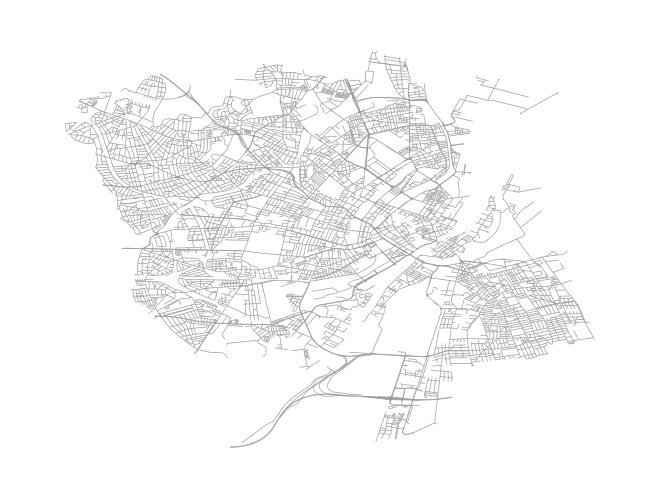

In [36]:
# %%capture
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Plotting networks")
    
    if prune_measure == "betweenness":
        weight_abstract = True
    else:
        weight_abstract = 6

        # EXISTING INFRASTRUCTURE
        # Load networks
    G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
    map_center = nxdraw(G_carall, "carall")

    # Load POIs
    with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
        nnids = [int(line.rstrip()) for line in f]
    nodesize_poi = nodesize_from_pois(nnids)

    fig = initplot()
    nxdraw(G_carall, "carall", map_center)
    nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
    plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_carall_poi_' + poi_source + '.pdf', bbox_inches="tight")
    plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_carall_poi_' + poi_source + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
    plt.close()
    
    for attr in attrlist:
        print("attribute: "+attr)

        # GENERATED, POI BASED
        # Load results
       
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+attr+".pickle"
        with open(PATH["results"] + placeid + "/" + filename, 'rb') as f:
            res = pickle.load(f)
        if debug: pp.pprint(res)

        # PLOT abstract MST
        fig = initplot()
        nxdraw(G_carall, "carall", map_center)
        nxdraw(res["MST_abstract"], "abstract", map_center, weighted = 6)
        nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
        nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in res["MST"].vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+  "/" + placeid + '_MSTabstract_poi_' + poi_source + '.pdf', bbox_inches="tight")
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTabstract_poi_' + poi_source + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
        plt.close()

        # PLOT MST all together
        fig = initplot()
        nxdraw(G_carall, "carall")
        nxdraw(res["MST"], "bikegrown", map_center, nodesize = nodesize_grown)
        nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
        nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in res["MST"].vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTall_poi_' + poi_source + '.pdf', bbox_inches="tight")
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTall_poi_' + poi_source + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
        plt.close()

        # PLOT MST all together with abstract
        fig = initplot()
        nxdraw(G_carall, "carall", map_center)
        nxdraw(res["MST"], "bikegrown", map_center, nodesize = 0)
        nxdraw(res["MST_abstract"], "abstract", map_center, weighted = 6)
        nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
        nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in res["MST"].vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTabstractall_poi_' + poi_source + '.pdf', bbox_inches="tight")
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTabstractall_poi_' + poi_source + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
        plt.close()

        # PLOT abstract greedy triangulation (this can take some minutes)
        for GT_abstract, prune_quantile in zip(res["GT_abstracts"], res["prune_quantiles"]):
            fig = initplot()
            nxdraw(G_carall, "carall")
            try:
                GT_abstract.es["weight"] = GT_abstract.es["width"]
            except:
                pass
            nxdraw(GT_abstract, "abstract", map_center, drawfunc = "nx.draw_networkx_edges", nodesize = 0, weighted = weight_abstract, maxwidthsquared = nodesize_poi)
            nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
            nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT_abstract.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid +"/"+attr+  "/" + placeid + '_GTabstract_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()

        # PLOT all together (this can take some minutes)
        for GT, prune_quantile in zip(res["GTs"], res["prune_quantiles"]):
            fig = initplot()
            nxdraw(G_carall, "carall")
            nxdraw(GT, "bikegrown", map_center, nodesize = nodesize_grown)
            nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
            nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid +"/"+attr+  "/" + placeid + '_GTall_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()


Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Plotting networks
length
bcount_attr
pop_den_attr
bcount_pop_den_attr


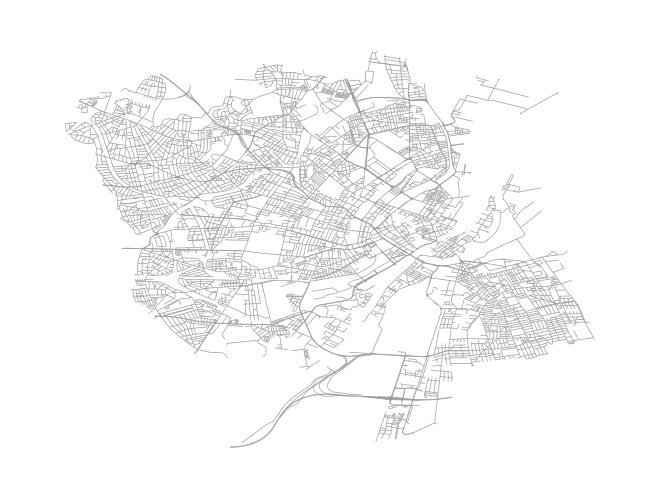

In [37]:
# %%capture
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Plotting networks")
    # Load POIs
    with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
        nnids = [int(line.rstrip()) for line in f]
    nodesize_poi = nodesize_from_pois(nnids)

    # EXISTING INFRASTRUCTURE
    # Load networks
    G_biketrack = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrack')
    G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
    G_biketrackcarall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrackcarall')
    G_bikeable = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'bikeable')
    map_center = nxdraw(G_carall, "carall")
    
    for attr in attrlist:
        print(attr)
        # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+attr+".pickle"
        with open(PATH["results"] + placeid + "/" + filename, 'rb') as f:
            res = pickle.load(f)


        # PLOT all together with overlaps (this can take some minutes)
        for GT, prune_quantile in zip(res["GTs"], res["prune_quantiles"]):
            fig = initplot()
            nxdraw(G_carall, "carall")
            nxdraw(G_biketrack, "biketrack", map_center, list(set([v["id"] for v in G_biketrack.vs]).intersection(set([v["id"] for v in G_carall.vs]))))
            nxdraw(GT, "bikegrown", map_center, nodesize = 0)
            nxdraw(GT, "highlight_biketrack", map_center, list(set([v["id"] for v in G_biketrack.vs]).intersection(set([v["id"] for v in GT.vs]))))
    #         nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
    #         nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid + "/" + attr+  "/" +placeid + '_GTalloverlapbiketrack_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()
            
        for GT, prune_quantile in zip(res["GTs"], res["prune_quantiles"]):
            fig = initplot()
            nxdraw(G_carall, "carall")
            nxdraw(G_bikeable, "bikeable", map_center, list(set([v["id"] for v in G_bikeable.vs]).intersection(set([v["id"] for v in G_carall.vs]))))
            nxdraw(GT, "bikegrown", map_center, nodesize = 0)
            nxdraw(GT, "highlight_bikeable", map_center, list(set([v["id"] for v in G_bikeable.vs]).intersection(set([v["id"] for v in GT.vs]))))
            nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
            nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid + "/" + attr+  "/" +placeid + '_GTalloverlapbikeable_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()

Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Plotting network covers


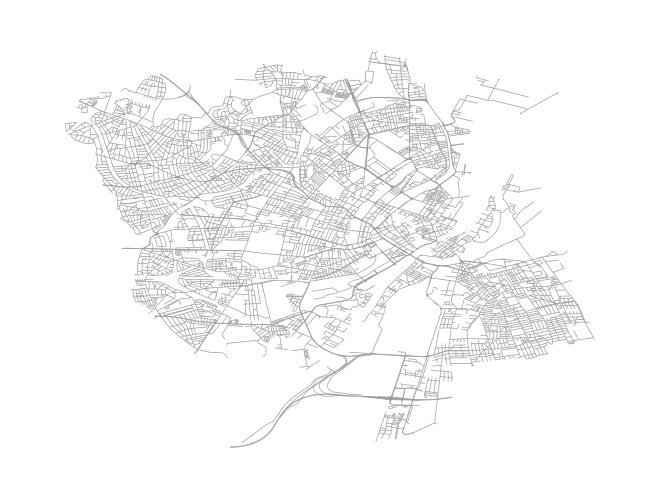

In [38]:
# %%capture
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Plotting network covers")

    # Load networks
    G_biketrack = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrack')
    G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
    G_biketrackcarall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrackcarall')
    G_bikeable = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'bikeable')
    map_center = nxdraw(G_carall, "carall")
    
    # Load POIs
    with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
        nnids = [int(line.rstrip()) for line in f]
    nodesize_poi = nodesize_from_pois(nnids)
    for attr in attrlist:

        # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure +"_"+attr+ ".pickle"
        with open(PATH["results"] + placeid + "/" + filename, 'rb') as f:
            res = pickle.load(f)

        # Load covers
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure +"_"+attr+ "_covers"
        with open(PATH["results"] + placeid + "/" + filename + ".pickle",'rb') as f:
            covs = pickle.load(f)
        filename = placeid + "_"  + "existing_covers"
        with open(PATH["results"] + placeid + "/" + filename + ".pickle",'rb') as f:
            cov_car = pickle.load(f)['carall']

        # Construct and plot patches from covers
        patchlist_car, patchlist_car_holes = cov_to_patchlist(cov_car, map_center)
        for GT, prune_quantile, cov in zip(res["GTs"], res["prune_quantiles"], covs.values()):
            fig = initplot()

            # Covers
            axes = fig.add_axes([0, 0, 1, 1]) # left, bottom, width, height (range 0 to 1)
            patchlist_bike, patchlist_bike_holes = cov_to_patchlist(cov, map_center)

            # We have this contrived order due to alphas, holes, and matplotlib's inability to draw polygon patches with holes. This only works because the car network is a superset of the bike network.
            # car orange, bike white, bike blue, bike holes white, bike holes orange, car holes white
            patchlist_combined = patchlist_car + patchlist_bike + patchlist_bike + patchlist_bike_holes+ patchlist_bike_holes + patchlist_car_holes
            pc = PatchCollection(patchlist_combined)
            colors = np.array([[255/255,115/255,56/255,0.2] for _ in range(len(patchlist_car))]) # car orange
            if len(patchlist_bike):
                colors = np.append(colors, [[1,1,1,1] for _ in range(len(patchlist_bike))], axis = 0) # bike white
                colors = np.append(colors, [[86/255,220/255,244/255,0.4] for _ in range(len(patchlist_bike))], axis = 0) # bike blue
            if len(patchlist_bike_holes):
                colors = np.append(colors, [[1,1,1,1] for _ in range(len(patchlist_bike_holes))], axis = 0) # bike holes white
            if len(patchlist_bike_holes):
                colors = np.append(colors, [[255/255,115/255,56/255,0.2] for _ in range(len(patchlist_bike_holes))], axis = 0) # bike holes orange
            if len(patchlist_car_holes):
                colors = np.append(colors, [[1,1,1,1] for _ in range(len(patchlist_car_holes))], axis = 0) # car holes white
            pc.set_facecolors(colors)
            pc.set_edgecolors(np.array([[0,0,0,0.4] for _ in range(len(patchlist_combined))])) # remove this line if the outline of the full coverage should remain
            axes.add_collection(pc)
            axes.set_aspect('equal')
            axes.set_xmargin(0.01)
            axes.set_ymargin(0.01)
            axes.plot()

            # Networks
            nxdraw(G_carall, "carall", map_center)
            nxdraw(GT, "bikegrown", map_center, nodesize = nodesize_grown)
            nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
            nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid + "/" +attr+"/"+ placeid + '_GTallcover_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()

In [43]:
debug = False # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"
plotconstricted = False # If True, will add plots about constricted street network metrics

### Setup

%run -i path.py
%run -i setupCPH.py
if not debug: # Only do this if sure the code is bug-free!
    warnings.filterwarnings('ignore')

%load_ext watermark
%watermark -n -v -m -g -iv

### Functions

%run -i functions.py


Loaded parameters.

Loaded PATH.

Setup finished.

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
Python implementation: CPython
Python version       : 3.8.2
IPython version      : 8.5.0

Compiler    : Clang 9.0.1 
OS          : Darwin
Release     : 18.7.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

Git hash: 40ca8c59f7b566fe66060109a7898e6e783a4eca

osmnx     : 0.16.2
sys       : 3.8.2 | packaged by conda-forge | (default, Apr 24 2020, 07:56:27) 
[Clang 9.0.1 ]
json      : 2.0.9
pyproj    : 3.4.0
geopandas : 0.11.1
numpy     : 1.23.3
shapely   : 1.8.4
sklearn   : 1.1.2
networkx  : 2.8.6
csv       : 1.0
pandas    : 1.4.4
matplotlib: 3.6.0
fiona     : 1.8.21
watermark : 2.3.1
geojson   : 2.5.0
igraph    : 0.9.1
osgeo     : 3.2.1

Loaded functions.



In [44]:
# %%capture

# Run all parameter sets
poi_source_list = ["grid"]
prune_measure_list = ["betweenness"]
parsets_used = list(itertools.product(poi_source_list, prune_measure_list))

for poi_source, prune_measure in parsets_used:
    print(poi_source, prune_measure)
        
        
    for placeid, placeinfo in tqdm(cities.items(), desc="Cities"):
        
        analysis_results = []
        analysis_mst_results = []
        
        for attr in attrlist:
            
        # PLOT Analysis
            filename = placeid + '_poi_' + poi_source + "_" + prune_measure +"_"+attr+ ".csv"
            analysis_result = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)
            if len(analysis_result) == 0: # No plot if no results (for example no railwaystations)
                print(placeid + ": No analysis results available")
                continue
            
            filename = placeid + '_poi_' + poi_source + "_"+ attr+ "_mst.csv"
            analysis_mst_result = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)
            
            analysis_results.append(analysis_result)
            analysis_mst_results.append(analysis_mst_result)
            
             

            # Load existing networks
        #G_biketrack = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'biketrack',attr)
        #G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall',attr)
        #G_bikeable = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'bikeable',attr)

        filename = placeid + "_existing.csv"
        analysis_existing = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)
        

        prune_quantiles_constricted = prune_quantiles
        if plotconstricted:
            f = PATH["results_constricted"] + "results_" + poi_source + "_" + prune_measure + "/metrics_" + poi_source + "_" + prune_measure + "/" + placeid + "_carconstrictedbike_poi_" + poi_source + "_" + prune_measure +"_"+attr+ ".csv"
            if os.path.isfile(f):
                analysis_result_constricted = np.loadtxt(f, delimiter=',', usecols = (2,3,4,5,6,7,8,9,10), skiprows=1)
                if np.shape(analysis_result_constricted)[0] == 3: # for large cities we only calculated 3 values
                    prune_quantiles_constricted = [prune_quantiles[19], prune_quantiles[-1]]
        nc = 4
        fig, axes = plt.subplots(nrows = 2, ncols = nc, figsize = (16, 6))
        # Bike network
        keys_metrics = {"length": "Length [km]","coverage": "Coverage [km$^2$]","overlap_biketrack": "Overlap Protected","directness_all_linkwise": "Directness","efficiency_global": "Global Efficiency",
                "pop_den_length": "Edgelengths x edge pop_den's","poi_coverage": "POIs covered","overlap_bikeable": "Overlap Bikeable"}
        for y in range(len(analysis_results)):
            for i, ax in enumerate(axes[0]):
                key = list(keys_metrics.keys())[i]
                if key in ["overlap_biketrack", "overlap_bikeable"]:
                    ax.plot(prune_quantiles, analysis_results[y][key] / analysis_results[y]["length"], **plotparam_analysis["bikegrown"][y])
                elif key in ["efficiency_global", "efficiency_local"]:
                    #ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown_abstract"])
                    xmin, xmax = ax.get_xlim()
                    #tmp, = ax.plot([xmin, xmax], [analysis_mst_results[y][key], analysis_mst_results[y][key]], **plotparam_analysis["mst"])  # MST is equivalent for abstract and routed
                    tmp.set_label('_hidden')
                    tmp, = ax.plot(prune_quantiles, analysis_results[y][key+"_routed"], **plotparam_analysis["bikegrown"][y])
                    tmp.set_label('_hidden')
                elif key in ["pop_den_length"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown"][y])
                    ymin, ymax = ax.get_ylim()
                    ax.set_ylim(ymin, ymax)
                elif key in ["length", "length_lcc"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_results[y][key]/1000, **plotparam_analysis["bikegrown"][y])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key]/1000, analysis_mst_results[y][key]/1000], **plotparam_analysis["mst"])
                else:
                    ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown"][y])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key], analysis_mst_results[y][key]], **plotparam_analysis["mst"])

                #try:
                    #if key in ["length", "length_lcc"]: # Convert m->km
                        #tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000, analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000], **plotparam_analysis["biketrack"])
                    #else:
                        #tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]], analysis_existing[key][analysis_existing_rowkeys["biketrack"]]], **plotparam_analysis["biketrack"])
                    #if key in ["efficiency_global", "efficiency_local"]:
                        #tmp.set_label('_hidden')

                    #if key in ["length", "length_lcc"]: # Convert m->km
                        #tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000, analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000], **plotparam_analysis["bikeable"])
                    #else:
                        #tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]], analysis_existing[key][analysis_existing_rowkeys["bikeable"]]], **plotparam_analysis["bikeable"])
                    #if key in ["efficiency_global", "efficiency_local"]:
                        #tmp.set_label('_hidden')
                #except:
                    #pass

                if key == "efficiency_global" and plotconstricted:
                    ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, 0], **plotparam_analysis["constricted"])

                if i == 0:
                    ymax0 = ax.get_ylim()[1]
                    ax.set_ylim(0, ymax0)
                    ax.text(-0.15, ymax0*1.25, placeinfo['name'] + " (" + poi_source + " | " + prune_measure + ") " + "Grown Networks", fontsize=16, horizontalalignment='left')
                    ax.legend(loc = 'upper left')

                if key == "directness_all_linkwise" and plotconstricted:
                    ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, -1], **plotparam_analysis["constricted"])

                set_analysissubplot(key)
                ax.set_title(list(keys_metrics.values())[i])
                ax.set_xlabel('')
                ax.set_xticklabels([])

        for y in range(len(analysis_results)):
            for i, ax in enumerate(axes[1]):
                key = list(keys_metrics.keys())[i+nc]
                if key in ["overlap_biketrack", "overlap_bikeable"]:
                    ax.plot(prune_quantiles, analysis_results[y][key] / analysis_results[y]["length"], **plotparam_analysis["bikegrown"][y])
                elif key in ["efficiency_global", "efficiency_local"]:
                    #ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown_abstract"])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key], analysis_mst_results[y][key]], **plotparam_analysis["mst"]) # MST is equivalent for abstract and routed
                    ax.plot(prune_quantiles, analysis_results[y][key+"_routed"], **plotparam_analysis["bikegrown"][y])
                elif key in ["pop_den_length"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown"][y])
                    ymin, ymax = ax.get_ylim()
                    ax.set_ylim(ymin, 1750000000)
                elif key in ["length", "length_lcc"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_results[y][key]/1000, **plotparam_analysis["bikegrown"][y])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key]/1000, analysis_mst_results[y][key]/1000], **plotparam_analysis["mst"])
                else:
                    ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown"][y])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key], analysis_mst_results[y][key]], **plotparam_analysis["mst"])
                #try:
                    #if key in ["length", "length_lcc"]: # Convert m->km
                        #ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000, analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000], **plotparam_analysis["biketrack"])
                        #ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000, analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000], **plotparam_analysis["bikeable"])
                    #else:
                        #if not (key == "poi_coverage" and poi_source == "railwaystation"):
                            #ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]], analysis_existing[key][analysis_existing_rowkeys["biketrack"]]], **plotparam_analysis["biketrack"])
                            #ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]], analysis_existing[key][analysis_existing_rowkeys["bikeable"]]], **plotparam_analysis["bikeable"])
                #except:
                    #pass
                if key == "efficiency_local" and plotconstricted:
                    ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, 1], **plotparam_analysis["constricted"])

                #if i == 1:
               #     ax.set_ylim(0, ymax0)
                #if i == 0:
                #    ax.legend(loc = 'best')
                set_analysissubplot(key)
                ax.set_title(list(keys_metrics.values())[i+nc])
                ax.set_xlabel(prune_measure + ' quantile')
                if key in ["poi_coverage"]:
                    # https://stackoverflow.com/questions/30914462/matplotlib-how-to-force-integer-tick-labels
                    ax.yaxis.set_major_locator(MaxNLocator(integer=True)) 

            plt.subplots_adjust(top = 0.87, bottom = 0.09, left = 0.05, right = 0.97, wspace = 0.25, hspace = 0.25)
        if plotconstricted:
            fig.savefig(PATH["plots"] + placeid + "/" + attr+"/" + placeid + '_analysis_poi_' + poi_source + "_" + prune_measure +"_"+attr+ '.png', facecolor = "white", edgecolor = 'none')
        else:
            fig.savefig(PATH["plots"] + placeid + "/" + placeid + '_analysis_poi_' + poi_source + "_" + prune_measure +"_"+attr+ '_noconstr.png', facecolor = "white", edgecolor = 'none')
        plt.close()

grid betweenness


Cities:   0%|          | 0/1 [00:00<?, ?it/s]

In [46]:
# %%capture

# Run all parameter sets
poi_source_list = ["grid"]
prune_measure_list = ["betweenness"]
parsets_used = list(itertools.product(poi_source_list, prune_measure_list))

for poi_source, prune_measure in parsets_used:
    print(poi_source, prune_measure)
        
        
    for placeid, placeinfo in tqdm(cities.items(), desc="Cities"):
        
        u = -1
        for attr in attrlist:
            u += 1    
            

        # PLOT Analysis
            filename = placeid + '_poi_' + poi_source + "_" + prune_measure +"_"+attr+ ".csv"
            analysis_result = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)
            if len(analysis_result) == 0: # No plot if no results (for example no railwaystations)
                print(placeid + ": No analysis results available")
                continue

            print(placeid + ": Plotting analysis results")

            # Load existing networks
            #G_biketrack = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'biketrack',attr)
            #G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall')
            #G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall',attr)
            #G_bikeable = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'bikeable',attr)

            #analysis_result = analysis_result2[:40]
            

            #G_biketrack = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrack')
            #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
            #G_bikeable = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'bikeable')


        #     G_biketrack_onstreet = intersect_igraphs(G_biketrack, G_carall)
        #     G_bikeable_onstreet = intersect_igraphs(G_bikeable, G_carall)


            filename = placeid + '_poi_' + poi_source + "_"+ attr+ "_mst.csv"
            analysis_mst_result = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)

            filename = placeid + "_existing.csv"
            analysis_existing = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)

            prune_quantiles_constricted = prune_quantiles
            if plotconstricted:
                f = PATH["results_constricted"] + "results_" + poi_source + "_" + prune_measure + "/metrics_" + poi_source + "_" + prune_measure + "/" + placeid + "_carconstrictedbike_poi_" + poi_source + "_" + prune_measure +"_"+attr+ ".csv"
                if os.path.isfile(f):
                    analysis_result_constricted = np.loadtxt(f, delimiter=',', usecols = (2,3,4,5,6,7,8,9,10), skiprows=1)
                    if np.shape(analysis_result_constricted)[0] == 3: # for large cities we only calculated 3 values
                        prune_quantiles_constricted = [prune_quantiles[19], prune_quantiles[-1]]
            nc = 5
            fig, axes = plt.subplots(nrows = 2, ncols = nc, figsize = (16, 6))
            # Bike network
            keys_metrics = {"length": "Length [km]","coverage": "Coverage [km$^2$]","overlap_biketrack": "Overlap Protected","directness_all_linkwise": "Directness","efficiency_global": "Global Efficiency",
                    "length_lcc": "Length of LCC [km]","poi_coverage": "POIs covered","overlap_bikeable": "Overlap Bikeable","components": "Components","directness": "-"}

            for i, ax in enumerate(axes[0]):
                key = list(keys_metrics.keys())[i]
                if key in ["overlap_biketrack", "overlap_bikeable"]:
                    ax.plot(prune_quantiles, analysis_result[key] / analysis_result["length"], **plotparam_analysis["bikegrown"][u])
                elif key in ["efficiency_global", "efficiency_local"]:
                    ax.plot(prune_quantiles, analysis_result[key], **plotparam_analysis["bikegrown_abstract"])
                    xmin, xmax = ax.get_xlim()
                    tmp, = ax.plot([xmin, xmax], [analysis_mst_result[key], analysis_mst_result[key]], **plotparam_analysis["mst"])  # MST is equivalent for abstract and routed
                    tmp.set_label('_hidden')
                    tmp, = ax.plot(prune_quantiles, analysis_result[key+"_routed"], **plotparam_analysis["bikegrown"][u])
                    tmp.set_label('_hidden')
                elif key in ["length", "length_lcc"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_result[key]/1000, **plotparam_analysis["bikegrown"][u])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key]/1000, analysis_mst_result[key]/1000], **plotparam_analysis["mst"])
                else:
                    ax.plot(prune_quantiles, analysis_result[key], **plotparam_analysis["bikegrown"][u])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key], analysis_mst_result[key]], **plotparam_analysis["mst"])

                try:
                    if key in ["length", "length_lcc"]: # Convert m->km
                        tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000, analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000], **plotparam_analysis["biketrack"])
                    else:
                        tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]], analysis_existing[key][analysis_existing_rowkeys["biketrack"]]], **plotparam_analysis["biketrack"])
                    if key in ["efficiency_global", "efficiency_local"]:
                        tmp.set_label('_hidden')

                    if key in ["length", "length_lcc"]: # Convert m->km
                        tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000, analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000], **plotparam_analysis["bikeable"])
                    else:
                        tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]], analysis_existing[key][analysis_existing_rowkeys["bikeable"]]], **plotparam_analysis["bikeable"])
                    if key in ["efficiency_global", "efficiency_local"]:
                        tmp.set_label('_hidden')
                except:
                    pass

                #if key == "efficiency_global" and plotconstricted:
                    #ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, 0], **plotparam_analysis["constricted"])

                if i == 0:
                    ymax0 = ax.get_ylim()[1]
                    ax.set_ylim(0, ymax0)
                    ax.text(-0.15, ymax0*1.25, placeinfo['name'] + " (" + poi_source + " | " + prune_measure + ")", fontsize=16, horizontalalignment='left')
                    ax.legend(loc = 'upper left')
                if i == 4:
                    ax.legend(loc = 'best')

                #if key == "directness_all_linkwise" and plotconstricted:
                 #   ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, -1], **plotparam_analysis["constricted"])

                set_analysissubplot(key)
                ax.set_title(list(keys_metrics.values())[i])
                ax.set_xlabel('')
                ax.set_xticklabels([])


            for i, ax in enumerate(axes[1]):
                key = list(keys_metrics.keys())[i+nc]
                if key in ["overlap_biketrack", "overlap_bikeable"]:
                    ax.plot(prune_quantiles, analysis_result[key] / analysis_result["length"], **plotparam_analysis["bikegrown"][u])
                elif key in ["efficiency_global", "efficiency_local"]:
                    ax.plot(prune_quantiles, analysis_result[key], **plotparam_analysis["bikegrown_abstract"])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key], analysis_mst_result[key]], **plotparam_analysis["mst"]) # MST is equivalent for abstract and routed
                    ax.plot(prune_quantiles, analysis_result[key+"_routed"], **plotparam_analysis["bikegrown"][u])
                elif key in ["length", "length_lcc"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_result[key]/1000, **plotparam_analysis["bikegrown"][u])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key]/1000, analysis_mst_result[key]/1000], **plotparam_analysis["mst"])
                else:
                    ax.plot(prune_quantiles, analysis_result[key], **plotparam_analysis["bikegrown"][u])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key], analysis_mst_result[key]], **plotparam_analysis["mst"])
                try:
                    if key in ["length", "length_lcc"]: # Convert m->km
                        ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000, analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000], **plotparam_analysis["biketrack"])
                        ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000, analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000], **plotparam_analysis["bikeable"])
                    else:
                        if not (key == "poi_coverage" and poi_source == "railwaystation"):
                            ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]], analysis_existing[key][analysis_existing_rowkeys["biketrack"]]], **plotparam_analysis["biketrack"])
                            ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]], analysis_existing[key][analysis_existing_rowkeys["bikeable"]]], **plotparam_analysis["bikeable"])
                except:
                    pass
                #if key == "efficiency_local" and plotconstricted:
                #    ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, 1], **plotparam_analysis["constricted"])

                if i == 0:
                    ax.set_ylim(0, ymax0)
                set_analysissubplot(key)
                ax.set_title(list(keys_metrics.values())[i+nc])
                ax.set_xlabel(prune_measure + ' quantile')
                if key in ["poi_coverage"]:
                    # https://stackoverflow.com/questions/30914462/matplotlib-how-to-force-integer-tick-labels
                    ax.yaxis.set_major_locator(MaxNLocator(integer=True)) 

            plt.subplots_adjust(top = 0.87, bottom = 0.09, left = 0.05, right = 0.97, wspace = 0.25, hspace = 0.25)
            if plotconstricted:
                fig.savefig(PATH["plots"] + placeid + "/" + attr+"/" + placeid + '_analysis_poi_' + poi_source + "_" + prune_measure +"_"+attr+ '.png', facecolor = "white", edgecolor = 'none')
            else:
                fig.savefig(PATH["plots"] + placeid + "/" + attr+"/" + placeid + '_analysis_poi_' + poi_source + "_" + prune_measure +"_"+attr+ '_noconstr.png', facecolor = "white", edgecolor = 'none')
            plt.close()

grid betweenness


Cities:   0%|          | 0/1 [00:00<?, ?it/s]

copenhagen: Plotting analysis results
copenhagen: Plotting analysis results
copenhagen: Plotting analysis results
copenhagen: Plotting analysis results


In [90]:
G_carall = ox.load_graphml('../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml')

In [104]:
length_dict = [float(x) for x in list(nx.get_edge_attributes(G_carall, 'length').values())]

In [105]:
bcount_dict =[float(x) for x in list(nx.get_edge_attributes(G_carall, 'bcount_attr').values())]

In [106]:
pop_den_dict =[float(x) for x in list(nx.get_edge_attributes(G_carall, 'pop_den_attr').values())]

In [107]:
bcount_pop_den_dict =[float(x) for x in list(nx.get_edge_attributes(G_carall, 'bcount_pop_den_attr').values())]

In [108]:
i= -1
for e in G_carall.edges():
    i+=1
    a,b=e
    nx.set_edge_attributes(G_carall, {(a,b,0): {"length": float(bcount_dict[i])}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"bcount_attr": float(bcount_dict[i])}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"pop_den_attr": float(pop_den_dict[i])}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"bcount_pop_den_attr": float(bcount_pop_den_dict[i])}})

In [109]:
btw_bcount_pop_den_attr = nx.edge_betweenness_centrality(G_carall,  weight='length')

KeyboardInterrupt: 

In [110]:
btw_bcount_pop_den_attr = nx.edge_betweenness_centrality(G_carall,  weight='bcount_attr')

TypeError: '<' not supported between instances of 'str' and 'float'

In [ ]:
btw_bcount_pop_den_attr = nx.edge_betweenness_centrality(G_carall,  weight='pop_den_attr')

In [54]:
btw_bcount_pop_den_attr = nx.edge_betweenness_centrality(G_carall,  weight='bcount_pop_den_attr')

TypeError: unsupported operand type(s) for +: 'int' and 'str'

In [112]:
G_carall = copy.deepcopy(GG_carall)

with open("../../bikenwgrowth_external/data/copenhagen/bikedata/mean_pop_den_attr.pkl", 'rb') as f:
    mean_pop_den_attr = pickle.load(f)
with open("../../bikenwgrowth_external/data/copenhagen/bikedata/mean_bcount_attr.pkl", 'rb') as q:
    mean_bcount_attr = pickle.load(q)

## Set alpha

a = 0.5

unassigned_bcount_pop_den_attr = (a* mean_bcount_attr) + ((1-a)* mean_pop_den_attr)

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/unassigned_bcount_pop_den_attr.pkl', 'wb') as f:
    pickle.dump(unassigned_bcount_pop_den_attr, f)

## Add 'bcount_pop_den_attr' to carall graph

nx.set_edge_attributes(G_carall, 0.0, 'bcount_pop_den_attr')

ox_to_csv(G_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(G_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

ox.save_graphml(G_carall, "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")

with zipfile.ZipFile("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.zip", 'r') as zip_ref:
    zip_ref.extractall("../../bikenwgrowth_external/data/copenhagen/")

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

edges

## Calculate 'bcount_pop_den_attr' for each edge, and add to carall graph

#edges = edges.drop(edges.columns[[0,1,2,3,4,5,6,9,10,11,12,13,14,15,16,17,18,19,20,21]], axis=1)

edges['bcount_pop_den_attr'] = a* edges['bcount_attr'] + (1-a)*edges['pop_den_attr']
#edges['bcount_attr'] * edges['pop_den_attr']

edges

i=-1
for e in G_carall.edges():
    i+=1
    a,b=e
    bcount_pop_den_attr = edges['bcount_pop_den_attr'].iloc[i]
    nx.set_edge_attributes(G_carall, {(a,b,0): {"bcount_pop_den_attr": bcount_pop_den_attr}})

#normalise_graph_attr(G_carall, "bcount_pop_den_attr")

bcount_pop_den_attr_dict = nx.get_edge_attributes(G_carall, "bcount_pop_den_attr")

bcount_pop_den_attr_mean = statistics.mean([k for k in bcount_pop_den_attr_dict.values()])

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/mean_bcount_pop_den_att.pkl', 'wb') as f:
    pickle.dump(bcount_pop_den_attr_mean, f)

ox_to_csv(G_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(G_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

ox.save_graphml(G_carall, "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/edges_dict_bcount_pop_den_attr.pkl', 'wb') as f:
    pickle.dump(bcount_pop_den_attr_dict, f)

copenhagen: Successfully wrote graph carall
copenhagen: Successfully wrote graph carall_simplified
copenhagen: Successfully wrote graph carall
copenhagen: Successfully wrote graph carall_simplified


In [ ]:
btw_length = nx.edge_betweenness_centrality(G_carall,  weight='length')

In [118]:
norm_btw(btw_length)

{(118725, 2512504197, 0): 0.006671184881503714,
 (118725, 298795891, 0): 0.14640984789465758,
 (118730, 1051183834, 0): 0.196919252279453,
 (118731, 1051183809, 0): 0.09371501713317601,
 (118732, 6534097568, 0): 0.006208452935834448,
 (118732, 283603631, 0): 0.11313548940064871,
 (118733, 4924695578, 0): 0.006203702008928607,
 (118735, 8977396171, 0): 0.016872358463802955,
 (118735, 4393215585, 0): 0.1078910912185634,
 (118737, 2935851405, 0): 0.006204952252851197,
 (118738, 1051990746, 0): 0.006206702594342822,
 (118739, 588481105, 0): 0.006205452350420233,
 (118747, 6651812229, 0): 0.027879764342023126,
 (118747, 1052455426, 0): 0.17534861051391123,
 (118748, 1051183765, 0): 0.14673664498610345,
 (118749, 1052455244, 0): 0.146737395132457,
 (118750, 1052455372, 0): 0.14673839532759506,
 (118751, 3574460115, 0): 0.1475413103096414,
 (118751, 6651812218, 0): 0.02630428196541145,
 (118751, 118747, 0): 0.056492980113753526,
 (118752, 1052455274, 0): 0.14753955996814977,
 (118753, 7640808

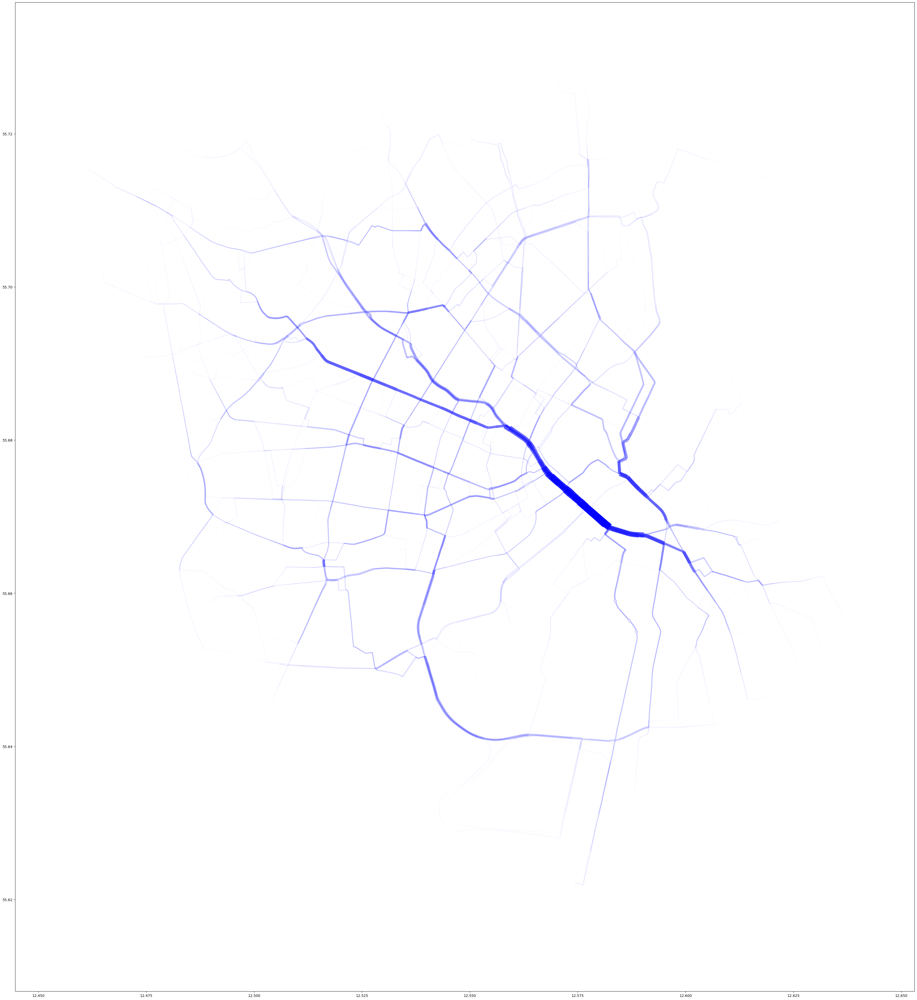

In [119]:
#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_length[k] for k in btw_length]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_length[k]*20 for k in btw_length]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [120]:
btw_bcount_attr = nx.edge_betweenness_centrality(G_carall,  weight='bcount_attr')

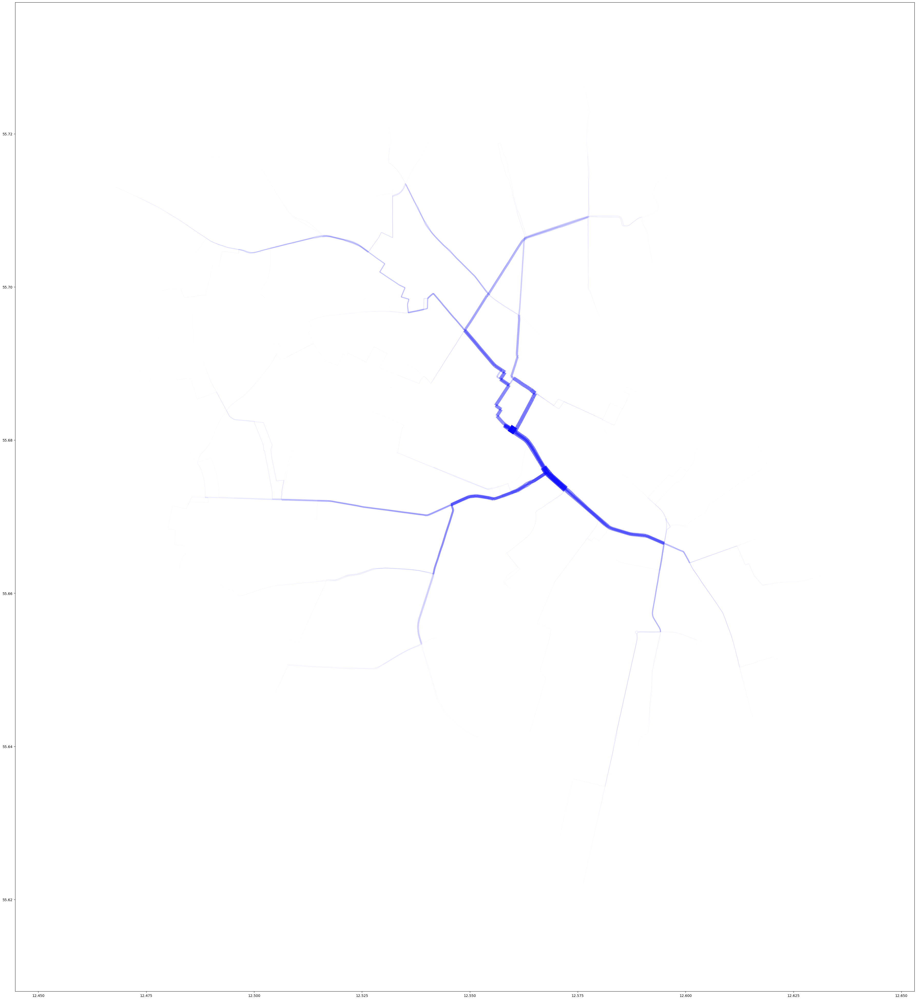

In [121]:
norm_btw(btw_bcount_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_attr[k] for k in btw_bcount_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_attr[k]*20 for k in btw_bcount_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [122]:
btw_pop_den_attr = nx.edge_betweenness_centrality(G_carall,  weight='pop_den_attr')

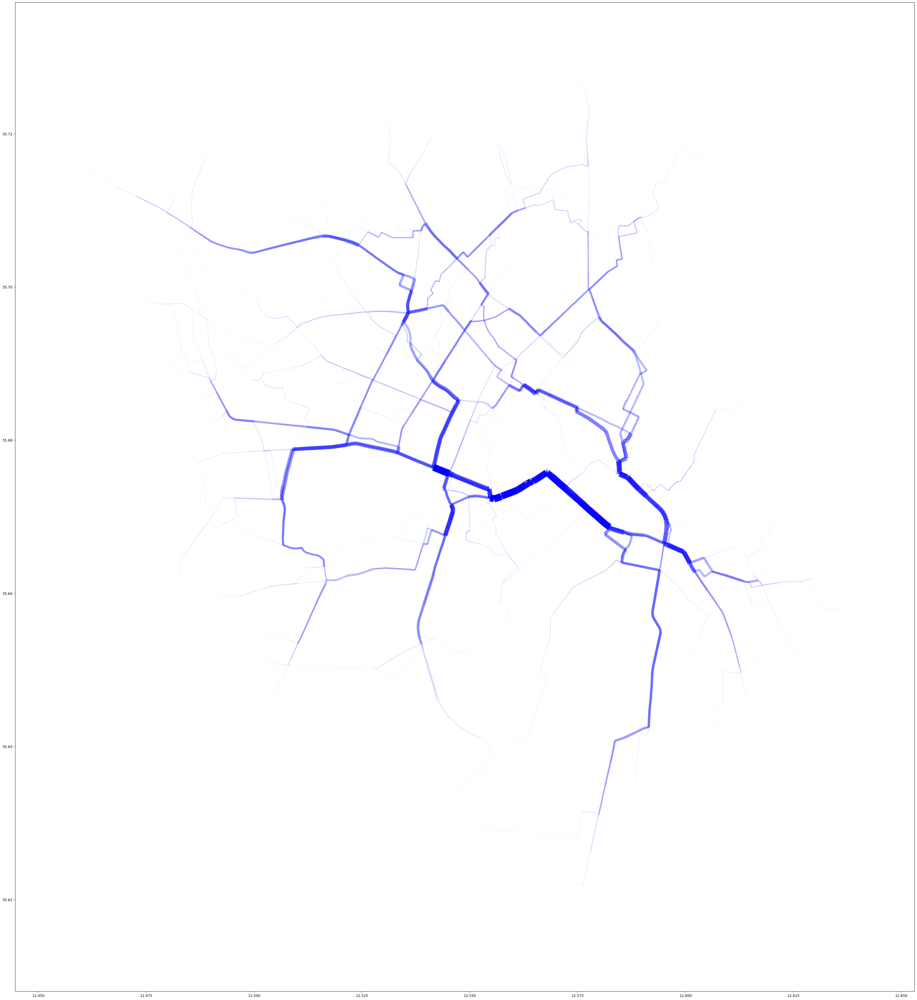

In [123]:
norm_btw(btw_pop_den_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_pop_den_attr[k] for k in btw_pop_den_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_pop_den_attr[k]*20 for k in btw_pop_den_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [124]:
btw_bcount_pop_den_attr = nx.edge_betweenness_centrality(G_carall,  weight='bcount_pop_den_attr')

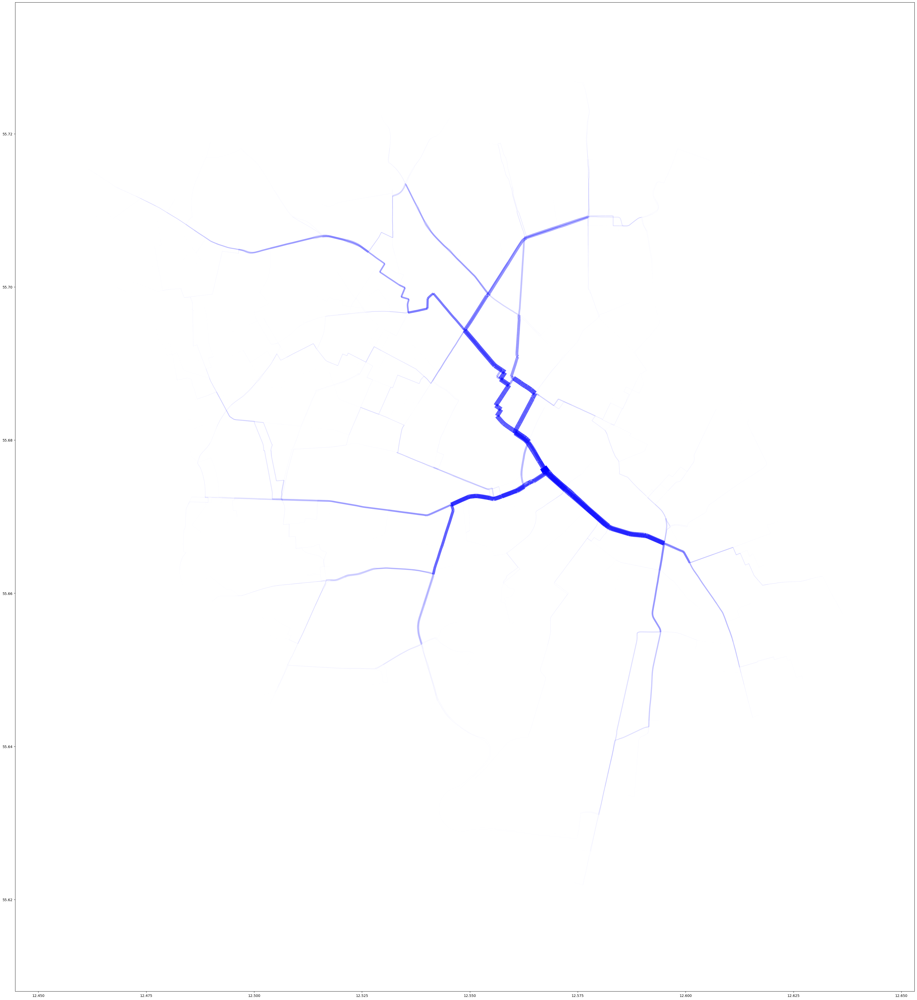

In [125]:
norm_btw(btw_bcount_pop_den_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_pop_den_attr[k] for k in btw_bcount_pop_den_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_pop_den_attr[k]*20 for k in btw_bcount_pop_den_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [116]:
def norm_btw(d):
    fn = lambda value, x_max, x_min: (value - x_min) / (x_max - x_min)
    d_norm= d
    # In each inner dict

    # find min and max values
    max_x = max(d.values())
    min_x = min(d.values())

    # normalize each value in the dict
    for k in d:
        d_norm[k] = fn(d[k], max_x, min_x)

    return d_norm

In [ ]:
norm(btw_length)

In [ ]:
norm(btw_bcount_attr)

In [ ]:
norm(btw_pop_den_attr)

In [ ]:
norm(btw_bcount_pop_den_attr )

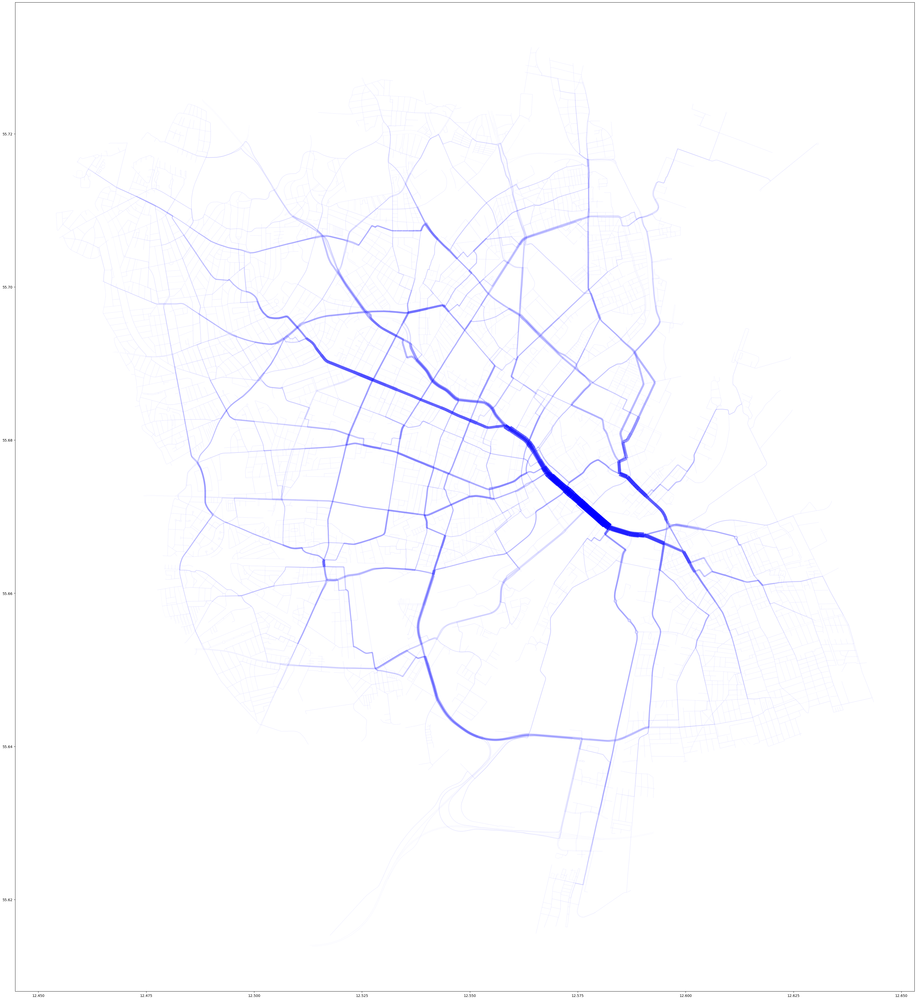

In [128]:
btw_length2 = btw_length.copy()
normalise_edge_dict2(btw_length2)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_length2[k] for k in btw_length2]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_length2[k]*20 for k in btw_length2]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

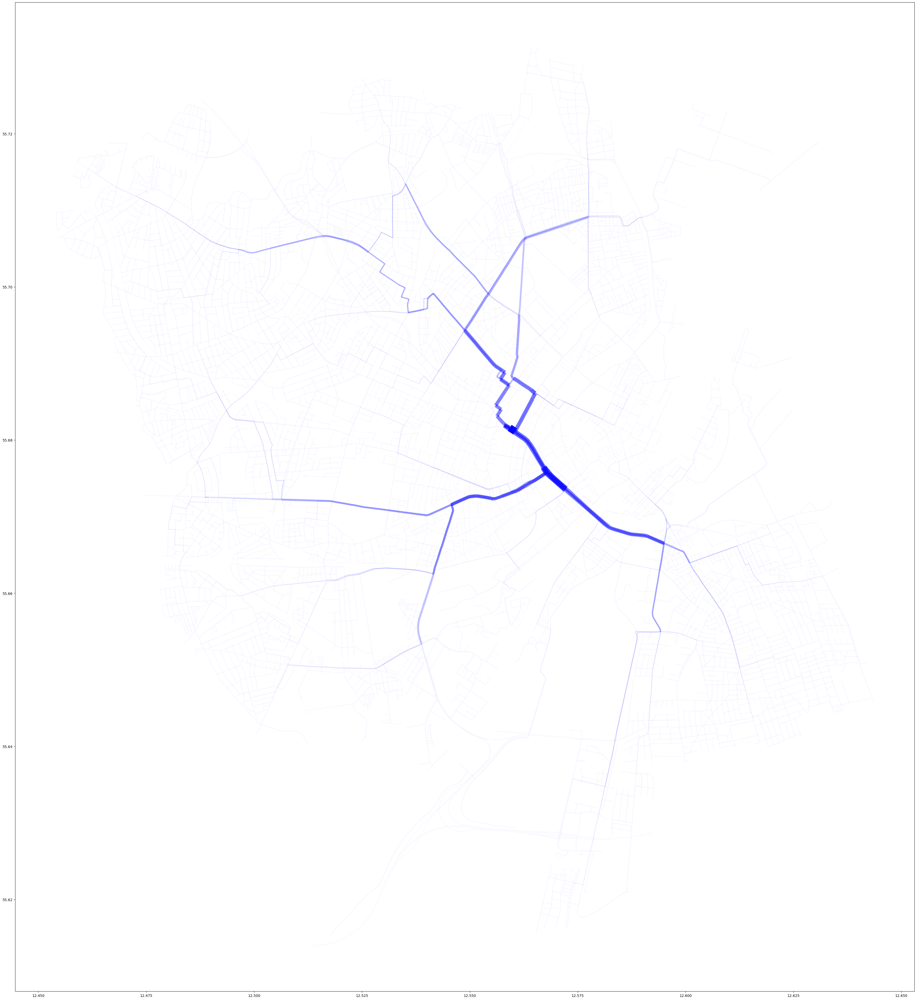

In [127]:
btw_bcount_attr2 = btw_bcount_attr.copy()
normalise_edge_dict2(btw_bcount_attr2)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_attr2[k] for k in btw_bcount_attr2]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_attr2[k]*20 for k in btw_bcount_attr2]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

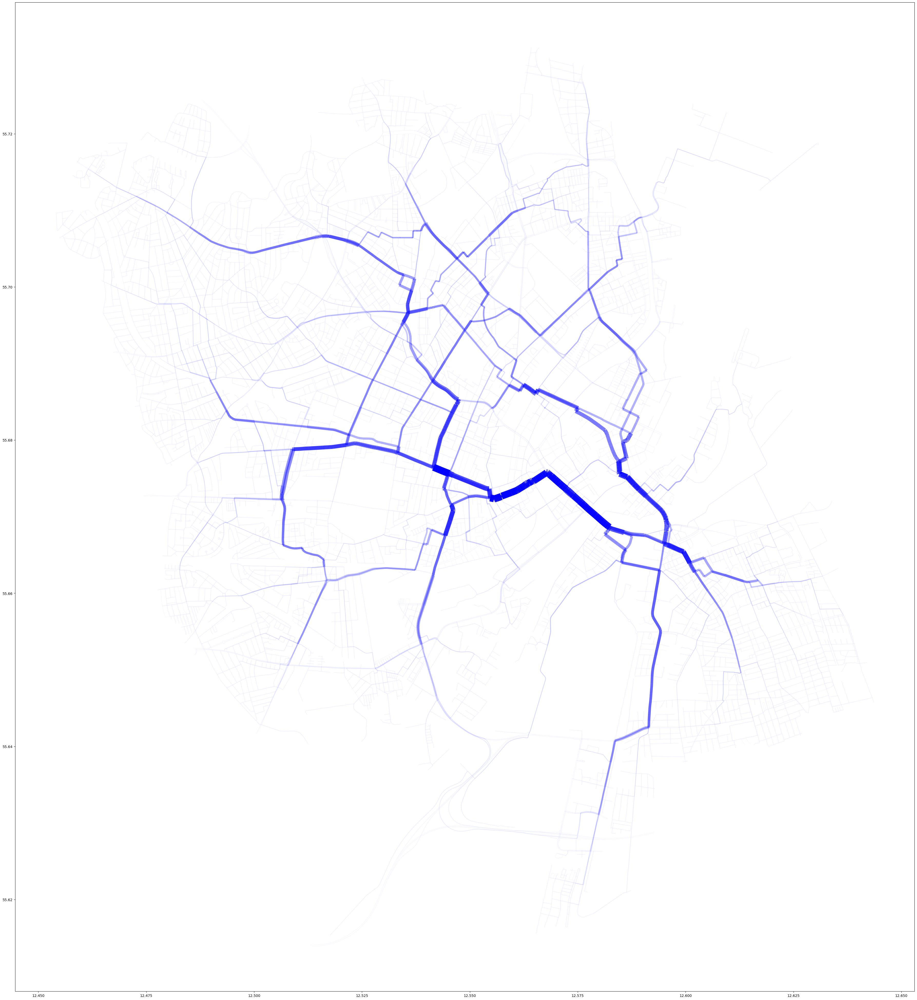

In [129]:
btw_pop_den_attr2 = btw_pop_den_attr.copy()
normalise_edge_dict2(btw_pop_den_attr2)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_pop_den_attr2[k] for k in btw_pop_den_attr2]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_pop_den_attr2[k]*20 for k in btw_pop_den_attr2]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

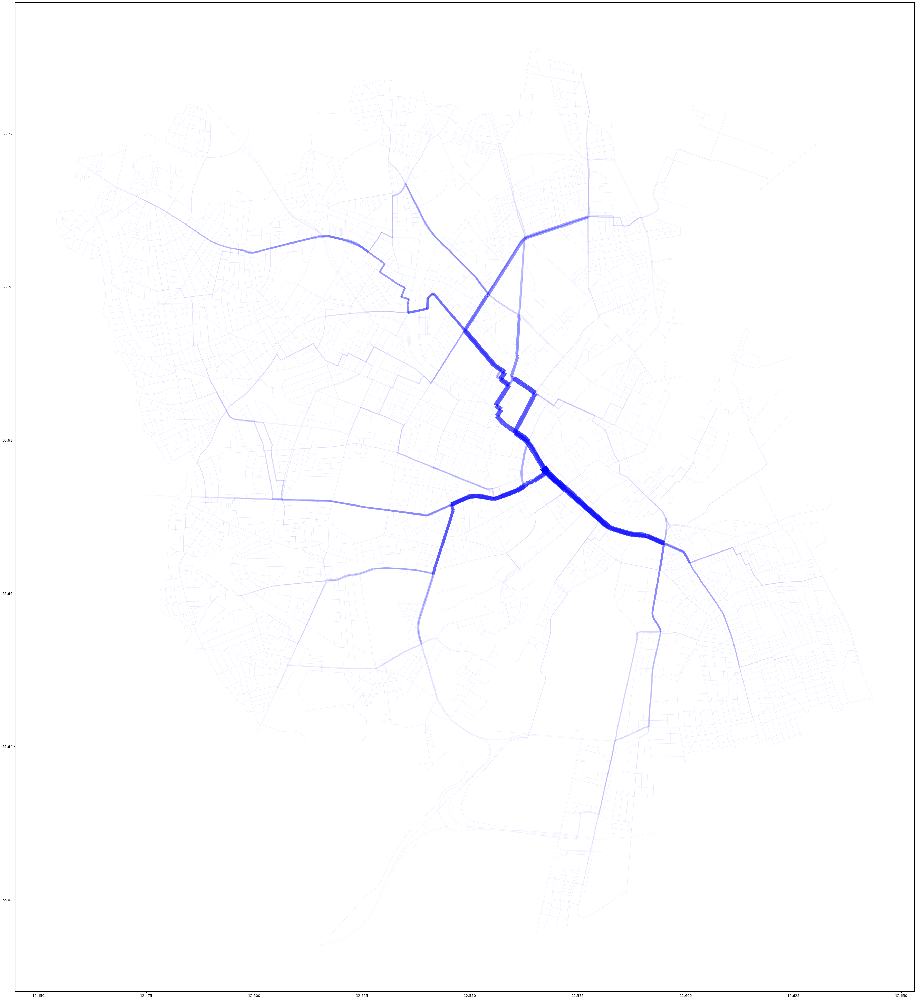

In [130]:
btw_bcount_pop_den_attr2 = btw_bcount_pop_den_attr.copy()
normalise_edge_dict2(btw_bcount_pop_den_attr2)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_pop_den_attr2[k] for k in btw_bcount_pop_den_attr2]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_pop_den_attr2[k]*20 for k in btw_bcount_pop_den_attr2]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [133]:
h = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall', 'length')

In [140]:
ebc = pd.DataFrame({"edge_ig": [e.index for e in h.es]})
#ebc["edge_nx"] = ebc.apply(lambda x: eids_conv.at[x.edge_ig, "nx"], axis = 1)
ebc["length"] = ebc.apply(lambda x: h.es[x.edge_ig]["length"], axis = 1)
ebc["ebc_length"] = h.edge_betweenness(directed = False, cutoff = None, weights = "length")
ebc["ebc_cutoff"] = h.edge_betweenness(directed = False, cutoff = 2500, weights = "length") 
#ebc["ebc_cost"] = h.edge_betweenness(directed = False, cutoff = None, weights = "cost")
ebc

,edge_ig,length,ebc_length,ebc_cutoff
0,0,30.958,12580512.0,472048.0
1,1,7.641,12904077.0,514668.0
2,2,15.342,350409.0,56439.0
3,3,20.750,12079003.0,563621.0
4,4,14.894,6256459.0,55192.0
...,...,...,...,...
39473,39473,9.785,2030820.0,87246.0
39474,39474,4.005,2394147.5,220860.0
39475,39475,4.138,13529848.0,322841.5
39476,39476,11.765,104154.0,10112.0


In [144]:
hey = nx.all_pairs_dijkstra_path_length(h, cutoff = 2500, weight = "length")

In [145]:
hey

<generator object all_pairs_dijkstra_path_length at 0x434069120>

In [132]:
btw_lengthhhh = nx.edge_betweenness_centrality(G_carall, cutoff= 2500, weight='length')

TypeError: argmap_edge_betweenness_centrality_28() got an unexpected keyword argument 'cutoff'